In [1]:
# increase nbr of symols to 16
# 50k observations (500k if possible)

import pandas as pd
import numpy as np
from numpy import save
import matplotlib.pyplot as plt
from scipy.fft import fft, fftshift

from scipy.linalg import dft
import scipy.constants as scipy_cst
from tqdm import tqdm
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.utils import shuffle
from sklearn.preprocessing import MinMaxScaler

In c:\python36\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The text.latex.preview rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In c:\python36\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The mathtext.fallback_to_cm rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In c:\python36\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: Support for setting the 'mathtext.fallback_to_cm' rcParam is deprecated since 3.3 and will be removed two minor releases later; use 'mathtext.fallback : 'cm' instead.
In c:\python36\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The validate_bool_maybe_none function was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In c:\python36\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The savefig.jpeg_quality rcparam was deprecated in Matplo

In [2]:
class Parameters :
    
    
    def __init__(self, bandwidth = 1e9, nsymbols=256, M = 16, Nt= 2**12, nLayers=100, timeMesh=50):
        
        # distance variables are converted in km
        #--------------------------------- variables ------------------------------------------------------#

        # distance
        self.L = 1000e3
        # bandwidth - 1 GHz
        self.B = bandwidth #1.2 

        #---------------------------------- physical constants --------------------------------------------#

        # power loss in dB
        self.a_dB = 0.2 
        # loss coefficient
        self.alpha = (1e-4)*np.log2(10)*self.a_dB
        # speed of light km/s
        self.c = 3e5
        # dispersion ps/(nm-km)
        self.D = 17*1e-12/(1e-9*1e03)
        #non-linearity coefficient - W^-1 km^-1
        self.gama = 1.27*1e-3
        # a constant factor
        self.nsp = 1
        # Planck constant - J.s
        self.h = scipy_cst.Planck
        # center wavelength - km
        self.lambda0 = 1.55e-9
        # center frequency
        self.f0 = self.c/self.lambda0    
        # dispersion coefficient
        self.beta2 = -(self.D*self.lambda0**2)/(2*np.pi*self.c)

        #---------------------------------- scale factors ------------------------------------------------#

        self.T0 = np.sqrt(np.abs(self.beta2*self.L)/2)
        self.P0 = 2/(self.gama*self.L)

        #----------------------------------- noise PSD ---------------------------------------------------#

        # physical noise 
        self.sigma02 = self.nsp*self.h*self.alpha*self.f0
        # normalized
        self.sigma2 = self.sigma02*self.L/(self.P0*self.T0) 

        #-------------------------------------------------------------------------------------------------#

        self.power = 6e-2
        self.l = 5
        self.nz = 500
        self.z = 10 #self.l/self.L #1

        #------------------------------------ time mesh --------------------------------------------------#

        # you have to choose this
        self.T = timeMesh #( (1/bandwidth)*self.nb ) + (10*2/ self.nb) #timeMesh # 200#20 # (1/B)*Ns + 10*2/B
        # you have to choose this
        self.N = Nt #2*10**2 #2**10
        self.dt = self.T/self.N
        self.t = np.linspace(-self.T/2, self.T/2, num=self.N, endpoint=True)

        #------------------------------------ frequency mesh ---------------------------------------------#

        self.F = 1/self.dt
        self.df = 1/self.T
        self.f = np.linspace(-self.F/2, self.F/2, num=self.N, endpoint=True) #np.fft.fftfreq(self.N, self.dt)
        self.omega = 2*np.pi*self.f

        #------------------------------------ bits to signal ---------------------------------------------#

        # size of the constellation
        self.M = M
        # number of symbols (or sinc functions); test with s=1
        self.n = nsymbols
        # number of bits
        self.nb = int(self.n * np.log2(self.M))
        # probability of zero
        self.p = 1/2
        
        #------------------------------------ Generative nnet ---------------------------------------------#
        
        # Number of the Layers of the Generative nnet 
        self.nbrLayers = nLayers
        # epsilon
        self.eps = self.z / self.nz
        
        # Amplitude for AWGN
        self.A = 2
        self.s = 2
    
    def setN(self,n):
        self.N = n
        self.__init__(N=n)
    
    def setNbrLayers(self,N):
        self.nbrLayers = N
        self.__init__(nbrLayers=N)

In [3]:
class NNetGenerator :

    #-------------------------------------------------------------------------------------------------#

    def __init__(self, parameters):
        self.params = parameters

    #-------------------------------------------------------------------------------------------------#

    def H(self, f, z):
        """ Compute the channel transfer function.
        @param f : frequency vector.
        @param z : scalar.
        """

        omega = 2*np.pi*f
        return np.exp(1j*z*omega**2)
       
    #-------------------------------------------------------------------------------------------------#

    def nnet_gen_old(self,  X):
        """ Simulate a NNet by computing the V matrix (V is Y in the implementation).
            @param X : data.
        """
        # reshaping the input
        
        #print("[INFO] starting {nnet_gen}...")
        #print("X : ",X)
        X = X.reshape((-1, 1))
        dz = self.params.z/self.params.nz

        #np.set_printoptions(precision=2, suppress=True)  # for compact output

        D = dft(X.size, scale='sqrtn')

        R = self.H(self.params.f,dz)

        W = np.dot(D.conj().T , np.dot(np.diag(R),D))

        # Deep Neural Network
        #print("[INFO] {nnet_gen} started generating the data...")

        for j in range(self.params.nbrLayers):

            # Linear transformation     
            X = np.dot(W, X)
            # Non-Linear transformation
            X = self.activation(X, dz)
            # Gaussian Noise 
            Z = self.addNoise(len(X), self.params.sigma02 , self.params.B, dz)
            
        # Output
        Y = np.squeeze(X + Z)

        return Y

    #-------------------------------------------------------------------------------------------------#

    def SpectrumAnalysis(self, x, Fs):
        L = int(np.power(2, np.ceil(np.log2(len(x)))))
        f = np.fft.fftshift(np.linspace(-Fs/2, Fs/2, L))
        x_fft = np.fft.fft(x, L)
        return np.abs(x_fft), f
    
    #-------------------------------------------------------------------------------------------------#

    def linearEffect(self, x, epsilon, Fs):

        L = int(np.power(2, np.ceil(np.log2(len(x)))))
        x_fft = np.fft.fft(x, L)
        f = np.fft.fftshift(np.linspace(-Fs/2, Fs/2, L))
        lamda = np.exp(1j * epsilon * ((2*f*np.pi)**2))
        x_ifft = np.fft.ifft(x_fft * lamda)
        x_ifft = np.delete(x_ifft, range(x.shape[0], L))

        return x_ifft 
    
    #-------------------------------------------------------------------------------------------------#

    def nonlinearEffect(self, x, epsilon):
        return x * np.exp(1j * 2 * epsilon * (np.abs(x)**2))
    
    #-------------------------------------------------------------------------------------------------#

    def add_noise(self, x, sigma02, B, epsilon):
        return np.random.normal(0, sigma02**2 * B * epsilon, x.shape)
    
    #-------------------------------------------------------------------------------------------------#

    def nnet_gen(self, X):
        
        epsilon = self.params.z / self.params.nz
        
        for i in range(self.params.nbrLayers):
            
            V = self.linearEffect(X, epsilon, self.params.F)
            U = self.nonlinearEffect(V, epsilon)
            Y = U + self.add_noise(U, self.params.sigma02, self.params.B, epsilon)
            X = Y
            
        return X

    #-------------------------------------------------------------------------------------------------#


    def activation(self, x, dz):
        """ Computes the activation of a neuron.
            @param X : data.
        """
        return x*np.exp(1j*dz*(np.absolute(x)**2))

    #-------------------------------------------------------------------------------------------------#


    def addNoise(self, n, sigma2, B, dz):
        """ Generate Gaussian noise. """
        Pn = sigma2 * B * dz

        Z = np.fft.fftshift(np.fft.ifft(np.random.normal(loc=0, scale=np.sqrt(Pn), size=(n, 1))))
        return Z
        
    #-------------------------------------------------------------------------------------------------#

In [4]:
class Channel :

    #-------------------------------------------------------------------------------------------------#

    def __init__(self):
        super()

    #-------------------------------------------------------------------------------------------------#

    def channel(self, t, q0t, z, sigma2, B) :
        # total noise power in B Hz and distance [0, z]
        a = sigma2*B*z 
        # get the f vector from t vector
        f = np.fft.fftfreq(t.size, 2*t[-1]/t.size)
        omega = 2*np.pi*f
        omega2 = omega**2
        # input in frequency
        q0f = np.fft.fft(q0t)
        #output in frequency
        hwz = np.exp(1j*z*omega2)
        # element-wise multiplication
        qzf = np.multiply(q0f,hwz) 
        #add Guassian noise in frequency, with correct variance
        N = len(f)
        qzf = qzf + np.random.normal(0, np.sqrt(a), qzf.shape)
        # back to time
        qzt = np.fft.ifft(qzf) 

        print("[channel] qzt :",qzt)
        print("[channel] qzf :",qzf)
        
        return qzt, qzf

In [5]:
class Transmitor :

    def __init__(self):
        super()


    #-------------------------------------------------------------------------------------------------#
    
    def source(self, N, p):
        """ Generates an N-bit sequence drawn from a Bernoulli stochastic process.
            @param N : Length of the bit sequence
            @param p : probability of 0
        """
        n=1
        return np.random.binomial(n, p, size=N)
    
    def source__(self, N, p):
        b = np.zeros((N, 1), dtype=np.int32)
        for i in range(N):
            x = np.random.choice([0, 1], p=[p, 1-p])
            b[i] = x
        return b


    #-------------------------------------------------------------------------------------------------#

    def build_constellations(self, M):
    
        """ Builds a M-QAM constellation.
            @param M : Number of symbols.
        """
        
        # Sequential address from 0 to M-1 (1xM dimension)
        n = np.arange(0,M)
        #convert linear addresses to Gray code
        a = np.asarray([x^(x>>1) for x in n])
        #Dimension of K-Map - N x N matrix
        D = np.sqrt(M).astype(int) 
        # NxN gray coded matrix
        a = np.reshape(a,(D,D))
        # identify alternate rows
        oddRows=np.arange(start = 1, stop = D ,step=2) 
        
        # reshape to 1xM - Gray code walk on KMap
        nGray=np.reshape(a,(M)) 
        
        #element-wise quotient and remainder
        (x,y)=np.divmod(nGray,D) 
        # PAM Amplitudes 2d+1-D - real axis
        Ax=2*x+1-D 
        # PAM Amplitudes 2d+1-D - imag axis
        Ay=2*y+1-D 
        constellation = Ax+1j*Ay
        
        self.constellation = constellation

        return constellation


    #-------------------------------------------------------------------------------------------------#

    def bit_to_symb_(self, b, cnt):
        """ Creates a mapping between bits sequences and symbols.
            @param b : N-bit sequence
            @param cnt : constellation
        """
        
        M = len(cnt)
        N = len(b)
        n = int(N/np.log2(M))
        pas = int(np.log2(M))
        """
        print("[bit_to_symb] M :",M)
        print("[bit_to_symb] N :",N)
        print("[bit_to_symb] n :",n)
        print("[bit_to_symb] pas :",pas)
        print("[bit_to_symb] b :",b)
        """

        #dictionary of mapping
        #mapping_dict = {}
        #mapping_list = []        
        mapping_list_symbols_only = []

        for i in range(n):
            # bit sequence
            s = b[pas*i:(pas*i)+pas]   
            s_str = ''.join(map(str, s)) # converts the bit array to string
            
            # avoids adding a 0 len string to the mapping
            if s_str != '' :
                symbol = cnt[i%M]
                #mapping_dict[s_str] = symbol
                #mapping_list.append((s_str,symbol))
                mapping_list_symbols_only.append(symbol)


        #self.b2sMapping_dict = mapping_dict
        #self.b2sMapping_list = mapping_list

        """
        print("[bit_to_symb] mapping_dict :",mapping_dict)
        print("[bit_to_symb] mapping_dict len :",len(mapping_dict))
        print("[bit_to_symb] mapping_list len :",len(mapping_list))
        print("[bit_to_symb] mapping_list[0] :",mapping_list[0])
        print("mapping_list[0][0] : ", type(mapping_list[0][1]))
        """
        return mapping_list_symbols_only
    
    #-------------------------------------------------------------------------------------------------#

    def bit_to_symb(self, b, M):
        k = int(np.log2(M))
        
        if b.size % k != 0:
            b = np.vstack((b, np.zeros((6-b.size % k, 1), dtype=np.uint8)))
            
        bits = b.reshape((-1, k))
        
        symboles = []
        for bi in bits:
            biDec = np.packbits(np.hstack((np.zeros(8-k, dtype=np.uint8), bi)))[0]
            bin, code = self.grayCoding(biDec, M)
            symboles.append(code)

        return np.array(symboles)
    
    #-------------------------------------------------------------------------------------------------#

    def grayCoding(self, n, M):
        k = int(np.log2(M))

        reAxis = np.hstack((np.arange(-(np.sqrt(M)//2), 0, step=1),
                            np.arange(1, np.sqrt(M)/2+1, step=1)))
        imAxis = np.copy(reAxis)

        bin = np.unpackbits(np.array([n], dtype=np.uint8))[8-k:]

        rePart = bin[:k//2]
        imPart = bin[k//2:]

        aReBin = np.hstack((np.zeros(8-k//2, dtype=np.uint8), rePart))
        aImBin = np.hstack((np.zeros(8-k//2, dtype=np.uint8), imPart))

        aReDec = np.packbits(aReBin)
        aImDec = np.packbits(aImBin)

        reIndex = np.bitwise_xor(aReDec, aReDec//2)[0]
        imIndex = np.bitwise_xor(aImDec, aImDec//2)[0]

        return  bin, complex(reAxis[reIndex], imAxis[imIndex])
    
    #-------------------------------------------------------------------------------------------------#

In [6]:
class Modulator :

    #-------------------------------------------------------------------------------------------------#

    def __init__(self):
      super()

    #-------------------------------------------------------------------------------------------------#
    
    def mod_(self, t,S, B):
        """ Modulate symbols data.
            @param t : time.
            @param s : sequence of symbols.
            @param B : Bandwidth.
        """

        # number of symbols
        Ns = len(S)
        # init
        q0t = 0
             
        for i in range(Ns):
            q0t = q0t + np.sqrt(B)*S[i]*np.sinc(B*t-i) #np.sinc(B*t-i)
        
        norm = np.linalg.norm(q0t)
        q0t = q0t/norm
        """
        print("q0t : ", q0t)
        print("S : ", S)
        plt.plot(q0t)
        """
        return q0t
    
    def mod(self,t, s, B):
        Ns = len(s)  # Number of Symbols

        l1 = int(-(Ns/2))
        l2 = int((Ns/2) - 1)

        lRange = np.linspace(l1, l2, num=Ns, endpoint=True)

        q0t = 0# np.zeros((1, t.size), dtype=np.complex64)

        for sl, l in zip(s, lRange):
            q0t += sl * np.sinc(B*t - l)

        return np.sqrt(B)*q0t

    #-------------------------------------------------------------------------------------------------#


In [7]:
class Equalizer :

    #-------------------------------------------------------------------------------------------------#

    def __init__(self):
        super()

    #-------------------------------------------------------------------------------------------------#

    def equalize(self, t, qzt, z):
        
        # get the f vector from t vector
        f = np.fft.fftfreq(t.size, 2*t[-1]/t.size)
        # get the omega vector from f vector
        omega = 2*np.pi*f

        # compute omega² for h
        omega2 = omega**2

        # Channel transfer function
        hwz = np.exp(1j*z*omega2)
        hwz_1 = np.reciprocal(hwz)
        # input in frequency
        qzf = np.fft.fft(qzt)
        # output in frequency        
        qzfe = np.multiply(qzf,hwz_1)
        # back to time
        qzte = np.fft.ifft(qzfe)

        print("[Equalizer] qzte :",qzte)
        print("[Equalizer] qzfe :",qzfe)
        return qzte, qzfe

In [8]:
#-----------------------------------------------------------------------------------------#

# Generating the dataset
def generateDataset_old(nbrOfObservations, parameters):

    X = np.ndarray((parameters.N, nbrOfObservations), dtype=np.complex128)
    y = np.ndarray((parameters.N, nbrOfObservations), dtype=np.complex128)

    print("[INFO] Generating the dataset...")

    for i in tqdm(range(1,nbrOfObservations)):
        """
        #source
        source = transmitor.source(parameters.N , parameters.p)

        # Constellation
        constellation = transmitor.build_constellations(parameters.M)

        # Bits to Symboles 
        bitsToSymbols = transmitor.bit_to_symb(source, constellation)
        # Modulation
        q0t = modulator.mod(parameters.t, constellation, parameters.B)
        """
        q0t = parameters.A*np.exp(-parameters.t**2) 
        #q0f = np.fft.fft(q0t)
        X[i] = np.squeeze(q0t)

        # Neural Net Generator
        #Y = nnetGen.nnet_gen(q0t)
        Y = nnetGen.nnet_gen_old(q0t)

        y[i] = Y

    print("[INFO] The dataset is ready now !")
    return X, y
#-----------------------------------------------------------------------------------------#
# Generating the dataset
def generateDataset(nbrOfObservations, parameters, isGaussian=False, testing=False):

    X = np.ndarray((nbrOfObservations, parameters.N), dtype=np.complex128)
    y = np.ndarray((nbrOfObservations, parameters.N), dtype=np.complex128)

    print("[INFO] Generating the dataset...")
    #X = cp.asarray(X)
    #y = cp.asarray(y)

    #changed range from 0... not 1
    for i in tqdm(range(0,nbrOfObservations)):
        
        # Constellation
        constellation = transmitor.build_constellations(parameters.M)
        
        #source
        source = transmitor.source(parameters.nb , parameters.p) # USE IT FOR NEXT PART OF BITS
        
        # Bits to Symboles - symbol sequence
        #bitsToSymbols = transmitor.bit_to_symb(source, constellation)
        # symbol sequence
        #mapping_dict, mapping_list, mapping_list_symbols_only = transmitor.bit_to_symb(source, constellation)
        # we create a list of values of the complex symbols to use them in modulation
        val_s = transmitor.bit_to_symb(source, parameters.M)
        
        # we create a list of values of the complex symbols to use them in modulation
        #val_s = list(bitsToSymbols.values())
        
        # Modulation
        if testing:
            print("[INFO] Modulation...")  

        # channel - we take gaussian input
        if isGaussian:
            q0t = parameters.A*np.exp(-parameters.t**2) 
            #q0f = np.fft.fft(q0t)

        else :
            q0t = modulator.mod(parameters.t,val_s, parameters.B)  
            #q0f = np.fft.fft(q0t)

        # SOURCE IS THE SEQUENCE OF BITS TO BE LEARNED
        
        X[i] = np.squeeze(q0t)

        # Neural Net Generator
        #Y = nnetGen.nnet_gen_old(q0t) 
        Y = nnetGen.nnet_gen(q0t)
        y[i] = Y
        
        if i == 0 :
            print("[INFO] q0t.shape : ",q0t.shape)        
            print("[INFO] Y.shape : ",Y.shape)

            
    print("[INFO] The dataset is ready now !")
    return X, y

#-----------------------------------------------------------------------------------------#

def createDataFrame(X,y) :
    X_ = np.column_stack((X.real,X.imag))
    y_ = np.column_stack((y.real,y.imag))
    data = np.column_stack((X_,y_))

    df = pd.DataFrame(data)
    print("df.shape : ",df.shape)
    df.to_csv("generatedData.csv")
    
    return df

#-----------------------------------------------------------------------------------------#

def test_dataset(X, parameters, index):
  
    withPlot = True
    q0t = X[index] #fromRealToComplex(l)
    q0f = np.fft.fft(q0t)

    qzt, qzf = channel.channel(parameters.t, q0t, parameters.z, parameters.sigma02, parameters.B)

    # Equalization
    qzte, qzfe = equalizer.equalize(parameters.t, qzt, parameters.z)

    if withPlot :
        fig2, (ax1, ax2, ax3, ax4, ax5, ax6) = plt.subplots(6, figsize = (15, 15))
        fig2.tight_layout(pad=7.0)

        ###
        ax1.plot(parameters.t, np.squeeze(q0t.real), 'b-')
        ax1.set_xlabel("Time")
        ax1.set_ylabel("Re(q0t)")
        ax1.set_title("Modulation - Time plot - Re(q0t)")

        ###
        ax2.plot(parameters.f, np.squeeze(np.abs(q0f)), 'b-')
        ax2.set_xlabel("Freq")
        ax2.set_ylabel("Abs(q0f)")
        ax2.set_title("Modulation - Freq plot - |q0f|")

        ###        
        ax3.plot(parameters.t, np.squeeze(qzt.real), 'b-')
        ax3.set_xlabel("Time")
        ax3.set_ylabel("Re(qzt)")
        ax3.set_title("Channel - Time plot - Re(qzt)")

        ###
        ax4.plot(parameters.f, np.squeeze(np.abs(qzf)), 'b-')
        ax4.set_xlabel("Freq")
        ax4.set_ylabel("Abs(qzf)")
        ax4.set_title("Channel - Freq plot - |qzf|")

        ###
        ax5.plot(parameters.t, np.squeeze(qzte.real), 'b-')
        ax5.set_xlabel("Time")
        ax5.set_ylabel("Abs(qzf)")
        ax5.set_title("Equalization - Time plot - Re(qzte)")

        ###
        ax6.plot(parameters.f, np.squeeze(np.abs(qzfe)), 'b-')
        ax6.set_xlabel("Freq")
        ax6.set_ylabel("Abs(qzf)")
        ax6.set_title("Equalization - Freq plot - |qzfe|")

        plt.show()
        
#-----------------------------------------------------------------------------------------#

In [9]:
#-----------------------------------------------------------------------------------------#

def run(isGaussian=False, s=2):

    # builds the constellation 
    constellation = transmitor.build_constellations(parameters.M) # 16-QAM
    
    # Bernoulli source, random bits sequence
    b = transmitor.source(parameters.nb,parameters.p)
    print("b : ",b)

    # symbol sequence, we create a list of values of the complex symbols to use them in modulation
    #val_s = transmitor.bit_to_symb(b, constellation)
    val_s = transmitor.bit_to_symb(b, parameters.M)

    
    # modulation   

    # channel - we take gaussian input
    if isGaussian:
        print("isGaussian")
        q0t = parameters.A*np.exp(-parameters.t**2/s) 
        q0f = np.fft.fft(q0t)
        
    else :
        q0t = modulator.mod(parameters.t,val_s, parameters.B)  
        q0f = np.fft.fft(q0t)
    
        print("q0t : ",q0t)


    # Pass through the channel
    qzt, qzf = channel.channel(parameters.t, q0t, parameters.z, parameters.sigma02, parameters.B)

    # Equalization
    qzte, qzfe = equalizer.equalize(parameters.t, qzt, parameters.z)

    fig2, (ax1, ax2, ax3, ax4, ax5, ax6) = plt.subplots(6, figsize = (25, 25))
    fig2.tight_layout(pad=10.0)

    ###
    ax1.plot(parameters.t, np.squeeze(q0t.real), 'b-')
    ax1.set_xlabel("Time")
    ax1.set_ylabel("Re(q0t)")
    ax1.set_title("Modulation - Time plot - Re(q0t)")

    ###
    ax2.plot(parameters.f, np.squeeze(np.abs(q0f)), 'b-')
    ax2.set_xlabel("Freq")
    ax2.set_ylabel("Abs(q0f)")
    ax2.set_title("Modulation - Freq plot - |q0f|")

    ###        
    ax3.plot(parameters.t, np.squeeze(qzt.real), 'b-')
    ax3.set_xlabel("Time")
    ax3.set_ylabel("Re(qzt)")
    ax3.set_title("Channel - Time plot - Re(qzt)")

    ###
    ax4.plot(parameters.f, np.squeeze(np.abs(qzf)), 'b-')
    ax4.set_xlabel("Freq")
    ax4.set_ylabel("Abs(qzf)")
    ax4.set_title("Channel - Freq plot - |qzf|")

    ###
    ax5.plot(parameters.t, np.squeeze(qzte.real), 'b-')
    ax5.set_xlabel("Time")
    ax5.set_ylabel("Abs(qzf)")
    ax5.set_title("Equalization - Time plot - Re(qzte)")

    ###
    ax6.plot(parameters.f, np.squeeze(np.abs(qzfe)), 'b-')
    ax6.set_xlabel("Freq")
    ax6.set_ylabel("Abs(qzf)")
    ax6.set_title("Equalization - Freq plot - |qzfe|")

    plt.show()

#-----------------------------------------------------------------------------------------#

def test(X, parameter):

    # Signal
    if X is None :
        X = parameter.A*np.exp(-parameter.t**2/parameter.s)

    # NNet generator
    Y1 = nnetGen.nnet_gen(X)

    # Channel
    Y2, _ = channel.channel(parameter.t, X, parameter.z, 0, 0)

    # Equalizer
    Y2e, _ = equalizer.equalize(parameter.t, Y2, parameter.z)
    Y1e, _ = equalizer.equalize(parameter.t, np.squeeze(Y1), parameter.z)

    # Fourier Transform
    Xf = fftshift(fft(X))
    Yf = fftshift(fft(Y1))
    
    #Plots
    
    fig = plt.figure(figsize=(25, 25))
    
    # Input signal
    ax = fig.add_subplot(711)
    fig.suptitle('X -- Y1 -- Y2')
    ax.set_xlabel('Time')
    ax.set_ylabel('X')
    ax.plot(parameter.t, X, 'g--')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')

    # NNet generator
    ax = fig.add_subplot(712)
    ax.set_xlabel('Time')
    ax.set_ylabel('Y1')
    ax.plot(parameter.t, np.squeeze(np.absolute(Y1)), 'r--')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')
    
    # Signal after channel
    ax = fig.add_subplot(713)
    ax.set_xlabel('Time')
    ax.set_ylabel('Y2')
    ax.plot(parameter.t, np.absolute(Y2), 'b--')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')
    
    # NNet gen signal after equalization
    ax = fig.add_subplot(714)
    ax.set_xlabel('Time')
    ax.set_ylabel('Y1 equalized')
    ax.plot(parameter.t, np.absolute(Y1e), 'b--')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')
    
    # NNet gen signal after equalization
    ax = fig.add_subplot(715)
    ax.set_xlabel('Time')
    ax.set_ylabel('Y2 equalized')
    ax.plot(parameter.t, np.absolute(Y2e), 'b--')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')
    
    # Input vs output
    
    # in time
    ax = fig.add_subplot(716)
    ax.set_xlabel('Time')
    ax.plot(parameter.t, X, 'b--', label='input')
    ax.plot(parameter.t, np.absolute(Y2), 'r--', label='output')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')
    
    # in freq
    ax = fig.add_subplot(717)
    ax.set_xlabel('Frequency')
    ax.plot(parameter.f, np.absolute(Xf), 'b--', label='input')
    ax.plot(parameter.f, np.absolute(Yf), 'r--', label='output')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')

    plt.show()
    
#-----------------------------------------------------------------------------------------#

def test_generated(X, y, index, parameter):

    # Signal : X
    X = np.squeeze(X[index])
    
    # NNet generator : y
    y = np.squeeze(y[index])
    
    # Channel
    Y2, _ = channel.channel(parameter.t, X, parameter.z, 0, 0)

    # Equalizer
    Y2e, _ = equalizer.equalize(parameter.t, Y2, parameter.z)
    Y1e, _ = equalizer.equalize(parameter.t, np.squeeze(y), parameter.z)

    # Fourier Transform
    Xf = fftshift(fft(X))
    Yf = fftshift(fft(y))
    
    #Plots
    
    fig = plt.figure(figsize=(25, 25))
    
    # Input signal
    ax = fig.add_subplot(711)
    fig.suptitle('X -- Y1 -- Y2')
    ax.set_xlabel('Time')
    ax.set_ylabel('X')
    ax.plot(parameter.t, X, 'g--')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')

    # NNet generator
    ax = fig.add_subplot(712)
    ax.set_xlabel('Time')
    ax.set_ylabel('Y1')
    ax.plot(parameter.t, np.squeeze(np.absolute(y)), 'r--')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')
    
    # Signal after channel
    ax = fig.add_subplot(713)
    ax.set_xlabel('Time')
    ax.set_ylabel('Y2')
    ax.plot(parameter.t, np.absolute(Y2), 'b--')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')
    
    # NNet gen signal after equalization
    ax = fig.add_subplot(714)
    ax.set_xlabel('Time')
    ax.set_ylabel('Y1 equalized')
    ax.plot(parameter.t, np.absolute(Y1e), 'b--')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')
    
    # NNet gen signal after equalization
    ax = fig.add_subplot(715)
    ax.set_xlabel('Time')
    ax.set_ylabel('Y2 equalized')
    ax.plot(parameter.t, np.absolute(Y2e), 'b--')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')
    
    # Input vs output
    
    # in time
    ax = fig.add_subplot(716)
    ax.set_xlabel('Time')
    ax.plot(parameter.t, X, 'b--', label='input')
    ax.plot(parameter.t, np.absolute(Y2), 'r--', label='output')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')
    
    # in freq
    ax = fig.add_subplot(717)
    ax.set_xlabel('Frequency')
    ax.plot(parameter.f, np.absolute(Xf), 'b--', label='input')
    ax.plot(parameter.f, np.absolute(Yf), 'r--', label='output')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')

    plt.show()
    
#-----------------------------------------------------------------------------------------#

## Helpers

In [10]:
#----------------------------------------------------------------------------#

def fromComplexToReal(vect_im):
  
    vect_real = []

    for i in range(len(vect_im)) :
        tmp = []
        for j in range(len(vect_im[i])) :
            z = vect_im[i][j]
            tmp.append(z.real)
            tmp.append(z.imag)
        vect_real.append(tmp)

    vect_real = np.asarray(vect_real)
    print("{fromComplexToReal} vect_real.shape : ",vect_real.shape)

    return vect_real

#----------------------------------------------------------------------------#

def fromRealToComplex(vect_real):
  
    # init variables
    vect_im = []  

    # iterate over the vector
    for i in range(len(vect_real)) :
        tmp = []
        j = 0

        # we can't use for loop with range() we have no control over the index
        while j < len(vect_real[i]) :

          # y = a+j*b
          im = vect_real[i][j] + 1j*vect_real[i][j+1]
          # we already processed two elements 
          j = j + 2
          # append the new element to the output array
          tmp.append(im)

        # matrix i*j
        vect_im.append(tmp)
    
    # to numpy
    vect_im = np.asarray(vect_im)
    print("{fromRealToComplex} vect_im.shape : ",vect_im.shape)

    return vect_im

#----------------------------------------------------------------------------#

def prepareDataFrame(X, y) :

    X_real = fromComplexToReal(X)
    y_real = fromComplexToReal(y)

    data = np.column_stack((X_real,y_real))

    df_ = pd.DataFrame(data)

    scaler = MinMaxScaler()
    df_ = scaler.fit_transform(df_)
    df_ = shuffle(df_)

    print("{prepareDataFrame} df_.shape : ",df_.shape)

    return df_

#----------------------------------------------------------------------------#

def prepareTrainAndTestData(df, withReshape, ts):

  #df = df.set_index('Attribute',inplace=True)
  
    N_samples = df.shape[0]
    N_features = df.shape[1]//2
    N_cols = df.shape[1]

    if type(df) != np.ndarray :
        print("[INFO] - {prepareTrainAndTestData} converting from pandas to numpy...")
        df_np = df.to_numpy()
        X = df_np[:N_samples,0:N_features]
        y = df_np[:N_samples,N_features:N_cols]
    else :
        X = df[:N_samples,0:N_features]
        y = df[:N_samples,N_features:N_cols]

    N_features = len(X[0])

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=ts)

    N_samples_train = len(X_train)
    N_samples_test = len(X_test)

    if withReshape :
        X_train = X_train.reshape(N_samples_train, N_features, 1)
        X_test = X_test.reshape(N_samples_test, N_features, 1)
        y_train = y_train.reshape(N_samples_train, N_features, 1)
        y_test = y_test.reshape(N_samples_test, N_features, 1)

    print(X.shape)
    print(y.shape)
    print(X_train.shape)
    print(y_train.shape)
    print(X_test.shape)
    print(y_test.shape)

    return X_train, X_test, y_train, y_test
  
#----------------------------------------------------------------------------#

In [71]:
bandwidth = 1e9                       # bandwidth
nsymbols = 64                        # Number of symbols
M = 16                                # size of the constellation
Nt = 2**10                            # Sample size
nLayers = 40                         # Number of Layers of the Generative network
nb = int(nsymbols * np.log2(M))       # Number of bits
timeMesh = 70 #(nb/bandwidth)+ (10*2/ nb)

In [72]:
timeMesh

70

In [73]:
# Initialize parameters
parameters = Parameters(bandwidth, nsymbols, M, Nt, nLayers, timeMesh)
params = Parameters(bandwidth, nsymbols, M, Nt, nLayers, timeMesh)
# Initialize the Transmitor
transmitor = Transmitor()
# Initialize the Transmitor
modulator = Modulator()
# Initialize the Channel
channel = Channel()
# Initialize the Equalizer
equalizer = Equalizer()
# Initialize the NNetGenerator
nnetGen = NNetGenerator(parameters)

In [74]:
nbrOfObservations = 5
X, y = generateDataset(nbrOfObservations, params, isGaussian=0)
X[0]

100%|████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 38.17it/s]

[INFO] Generating the dataset...
[INFO] q0t.shape :  (1024,)
[INFO] Y.shape :  (1024,)
[INFO] The dataset is ready now !


array([-1.97725796e-11+2.15221906e-11j, -1.42854795e-06-5.71415237e-07j,
        3.72554856e-07+1.49004463e-07j, ...,
        3.72527624e-07+1.49022570e-07j, -1.42854532e-06-5.71419098e-07j,
       -9.24956637e-12+3.35720083e-11j])

In [75]:
y[3]

array([-0.00035265-6.61315174e-05j, -0.0003862 -9.95484607e-05j,
        0.00029823+3.97215270e-05j, ..., -0.00029079-5.19947488e-05j,
        0.00039786+8.88607605e-05j,  0.0003428 +7.81635774e-05j])

[channel] qzt : [ 0.0008229 +0.0001733j   0.00027331-0.00012546j -0.0001476 -0.000226j
 ... -0.0001476 -0.00022599j  0.0002733 -0.00012546j
  0.00082291+0.00017329j]
[channel] qzf : [-0.00138719-0.01155995j  0.00041619+0.01162273j  0.00241546-0.01138957j
 ... -0.00653307+0.00962185j  0.00227551-0.01141836j
  0.0004875 +0.01161996j]
[Equalizer] qzte : [-2.08797796e-11+2.23221398e-11j -8.57127940e-07-7.14271266e-06j
  2.23509310e-07+1.86270782e-06j ...  2.23529111e-07+1.86267479e-06j
 -8.57125279e-07-7.14273713e-06j -1.05762573e-11+3.71313136e-12j]
[Equalizer] qzfe : [-0.00138719-0.01155995j  0.00135025+0.01155154j -0.00131624-0.01156824j
 ...  0.0014919 +0.01153409j -0.0014581 -0.01155122j
  0.0014211 +0.01154303j]
[Equalizer] qzte : [ 7.79836824e-05+1.42422665e-04j -1.59680438e-05+1.21310868e-04j
  4.82602791e-05-1.40439769e-04j ...  1.00090768e-04+1.36890221e-04j
  3.13595252e-04+8.57369626e-05j  2.97433243e-04+8.92173012e-05j]
[Equalizer] qzfe : [-0.00136852-0.01156218j  0.00210958+0

c:\python36\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
c:\python36\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


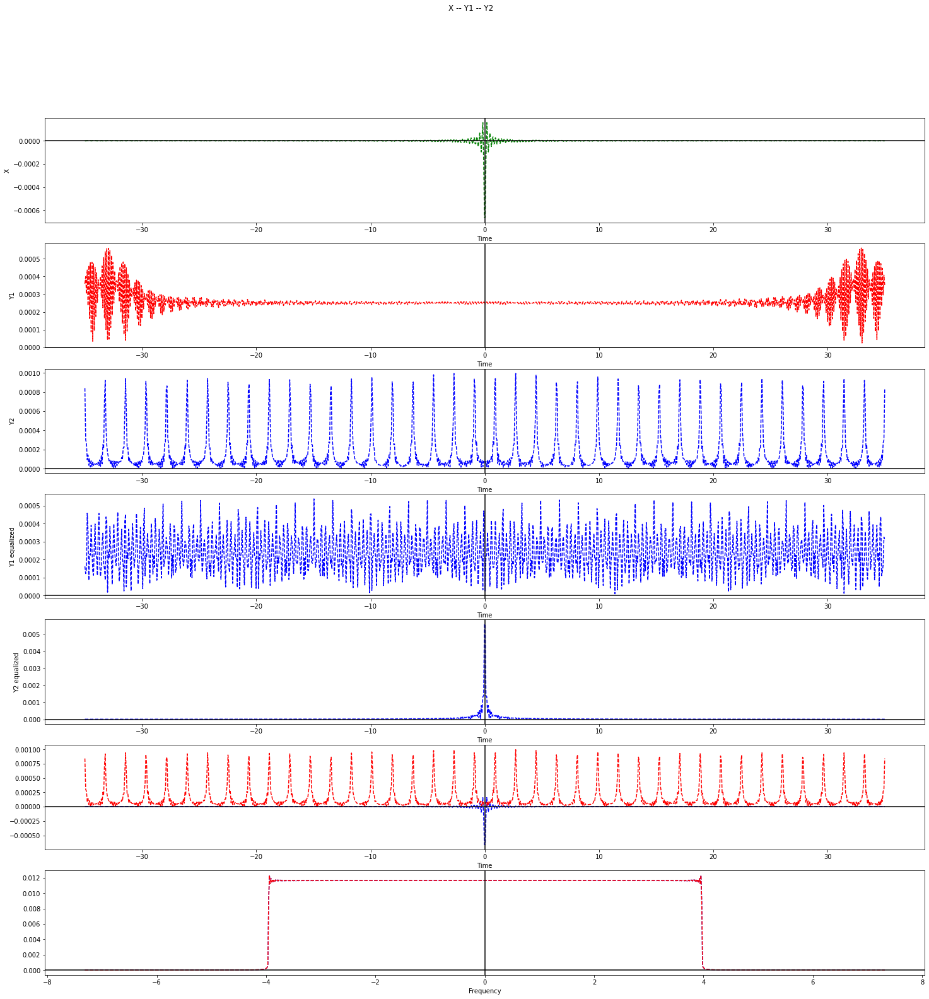

In [76]:
index=3
test_generated(X, y, index, params)

[channel] qzt : [-0.01102331+0.19378141j -0.01109695+0.19101669j -0.01124249+0.18552667j
 ... -0.01124249+0.18552667j -0.01109695+0.19101669j
 -0.01102331+0.19378141j]
[channel] qzf : [ 73.26516357 +0.j         -72.71612072 -6.09591746j
  68.24326466+23.25374642j ... -53.31381671-46.37541471j
  68.52348531+22.41454562j -72.75215571 -5.64962498j]
[Equalizer] qzte : [0.00000000e+00+1.27002183e-16j 1.11022302e-16+1.56978337e-17j
 0.00000000e+00-4.84157074e-17j ... 1.11022302e-16-9.50375999e-17j
 3.33066907e-16+1.13557126e-17j 1.11022302e-16-2.66204864e-17j]
[Equalizer] qzfe : [ 73.26516357+2.33146835e-15j -72.97084557-2.23872453e-01j
  72.09496653+4.42374726e-01j ... -70.65846861+6.50350764e-01j
  72.09496653-4.42374726e-01j -72.97084557+2.23872453e-01j]
[Equalizer] qzte : [-0.31991829-0.31234668j -0.30850481-0.2982485j  -0.29182531-0.27815717j
 ... -0.32080078-0.31344892j -0.32612989-0.32014264j
 -0.3258337 -0.3197689j ]
[Equalizer] qzfe : [-42.64998239+20.07919365j  41.2526105 -22.76401

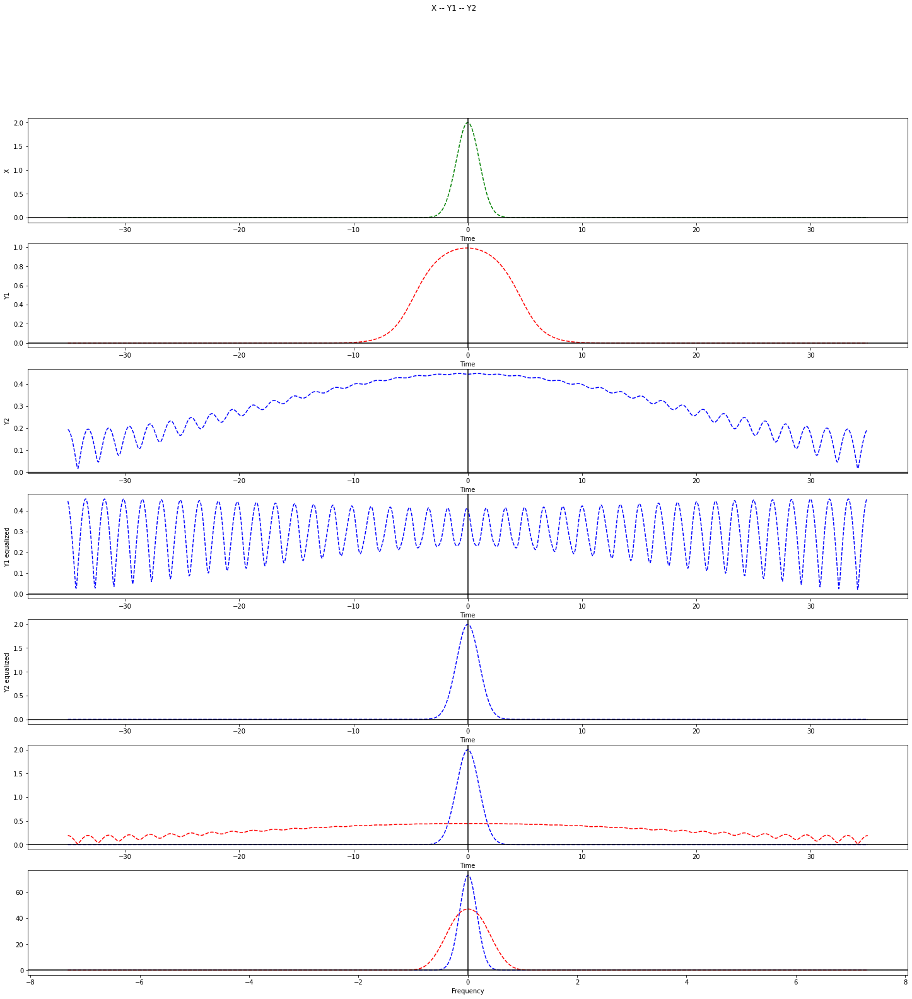

In [77]:
X=None
test(X, params)

## **Data generation**

In [15]:
nbrOfObservations = 400000
X, y = generateDataset(nbrOfObservations, params, isGaussian=0)

  0%|                                                                             | 2/400000 [00:00<7:26:39, 14.93it/s]

[INFO] Generating the dataset...
[INFO] q0t.shape :  (1024,)
[INFO] Y.shape :  (1024,)


100%|████████████████████████████████████████████████████████████████████████| 400000/400000 [4:36:56<00:00, 24.07it/s]


[INFO] The dataset is ready now !


In [16]:
nbrOfObservations = 60000
X, y = generateDataset(nbrOfObservations, params, isGaussian=0)

  0%|                                                                                | 2/60000 [00:00<57:00, 17.54it/s]

[INFO] Generating the dataset...
[INFO] q0t.shape :  (1024,)
[INFO] Y.shape :  (1024,)


100%|████████████████████████████████████████████████████████████████████████████| 60000/60000 [44:24<00:00, 22.52it/s]

[INFO] The dataset is ready now !


In [17]:
print(X.shape)
print(y.shape)

(60000, 1024)
(60000, 1024)


In [18]:
save('X_data.npy', X)
save('y_data.npy', y)

In [19]:
np.squeeze(X[0]).shape

(1024,)

[channel] qzt : [-0.00171128+5.43926766e-05j -0.00048004+3.80061010e-04j
  0.00040102+3.75760716e-04j ...  0.000401  +3.75751241e-04j
 -0.00048002+3.80051452e-04j -0.00171128+5.44160568e-05j]
[channel] qzf : [ 0.00832316+0.0221951j  -0.00643289-0.02278794j  0.0007196 +0.02369346j
 ...  0.00827789-0.02218441j  0.0010103 +0.02368284j
 -0.0065726 -0.02274804j]
[Equalizer] qzte : [ 3.75153584e-11-5.15301838e-11j  5.14275961e-06+1.37140018e-05j
 -1.34109842e-06-3.57632828e-06j ... -1.34117467e-06-3.57641415e-06j
  5.14276714e-06+1.37140480e-05j  1.95700899e-11-1.03427087e-10j]
[Equalizer] qzfe : [ 0.00832316+0.0221951j  -0.00824602-0.02219629j  0.00818682+0.02224576j
 ... -0.00851779-0.02209341j  0.00845919+0.02214362j
 -0.00838206-0.02214528j]
[Equalizer] qzte : [-2.22985005e-04-2.44060956e-04j -2.69669932e-05-2.47650599e-04j
 -2.76727768e-05+3.01071382e-04j ... -2.64040859e-04-2.22449909e-04j
 -6.61647124e-04-1.82249776e-05j -6.31358963e-04-3.29093289e-05j]
[Equalizer] qzfe : [ 0.00828728

c:\python36\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
c:\python36\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


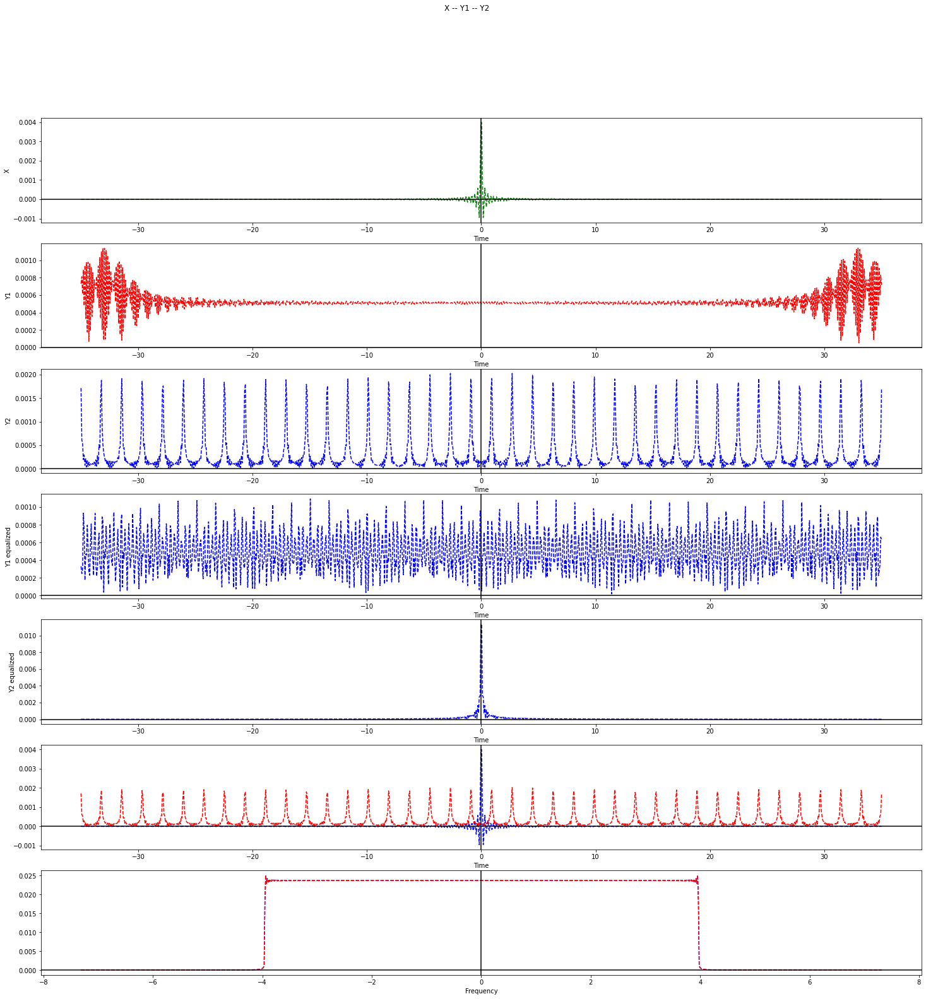

In [20]:
index=5
test_generated(X, y, index, params)

[channel] qzt : [ 0.00098492-0.00051235j  0.00017384-0.00035694j -0.00033991-0.00010701j
 ... -0.0003399 -0.00010701j  0.00017383-0.00035693j
  0.00098492-0.00051237j]
[channel] qzf : [-0.01109755-0.01063515j  0.01015922+0.01151248j -0.00707423-0.01364615j
 ...  0.00139165+0.01529085j -0.00724116-0.01355831j
  0.01022967+0.01144993j]
[Equalizer] qzte : [ 1.76415540e-11+3.69229183e-11j -6.85700584e-06-6.57129068e-06j
  1.78823587e-06+1.71363426e-06j ...  1.78813535e-06+1.71371705e-06j
 -6.85702391e-06-6.57131619e-06j -1.59994500e-12+7.88340023e-11j]
[Equalizer] qzfe : [-0.01109755-0.01063515j  0.0110528 +0.01065751j -0.01103209-0.01070305j
 ...  0.01118275+0.01052106j -0.0111626 -0.01056686j
  0.01111799+0.01058949j]
[Equalizer] qzte : [ 1.98867632e-04+8.00291212e-05j  8.53065696e-05+1.37171928e-04j
 -6.83740333e-05-1.83738910e-04j ...  2.16793568e-04+5.58668007e-05j
  3.91833451e-04-1.75153097e-04j  3.78255391e-04-1.58065395e-04j]
[Equalizer] qzfe : [-0.01108036-0.01065306j  0.01173198

c:\python36\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
c:\python36\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


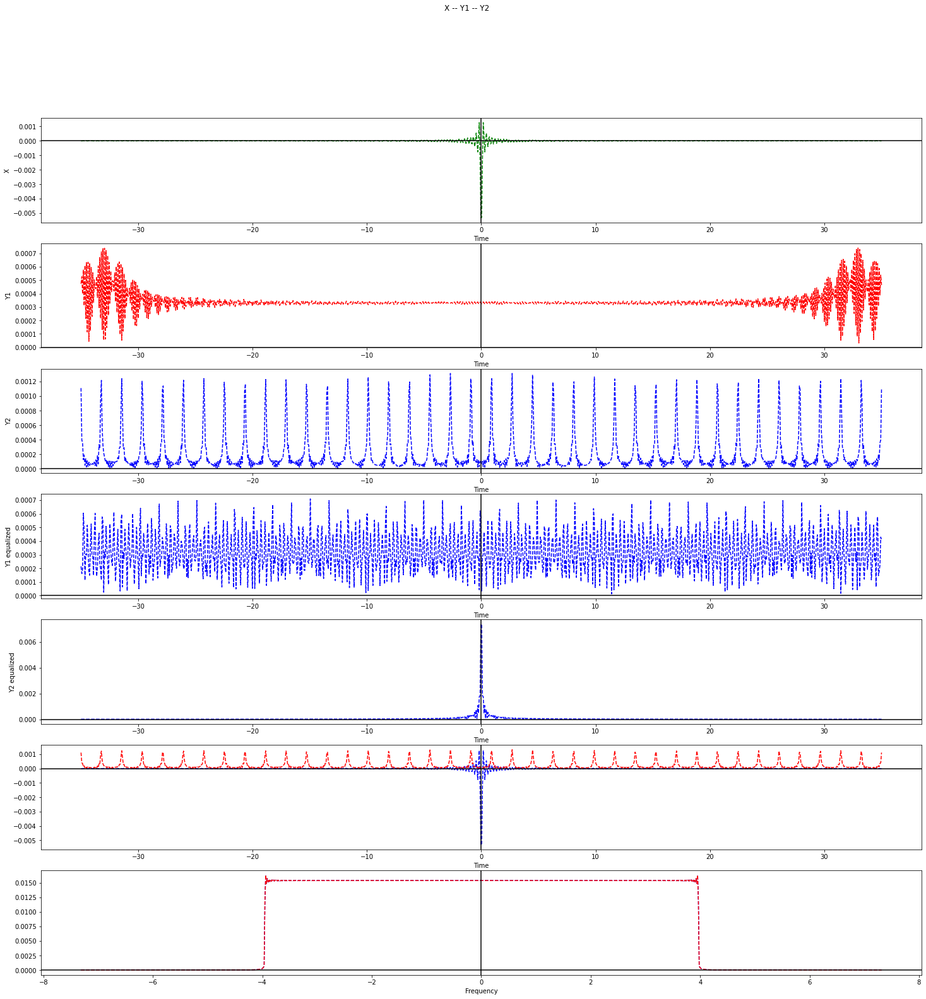

In [21]:
test(X[0], params)

c:\python36\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


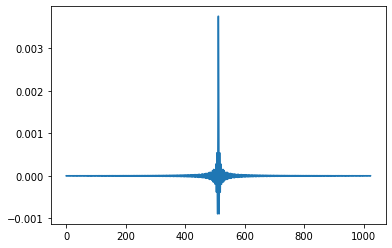

In [22]:
plt.plot(X[6550])

In [23]:
np.sum(y[0])

(-0.011080359782925936-0.01065306471808673j)

c:\python36\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


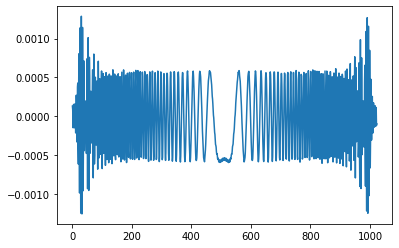

In [24]:
plt.plot(y[5600])

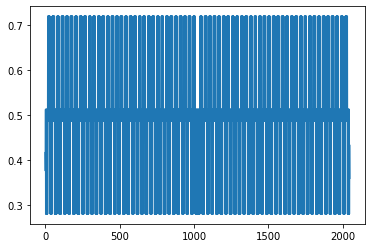

In [42]:
plt.plot(X_test[0])

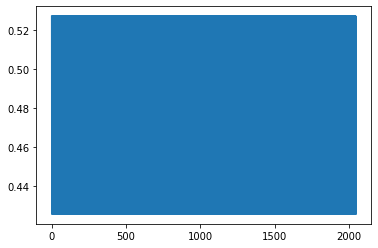

In [44]:
plt.plot(y_test[1])

In [25]:
X

array([[ 1.76415538e-11+3.69229190e-11j, -6.85700584e-06-6.57129068e-06j,
         1.78823587e-06+1.71363426e-06j, ...,
         1.78813535e-06+1.71371705e-06j, -6.85702391e-06-6.57131619e-06j,
        -1.59994460e-12+7.88340026e-11j],
       [-1.21440756e-11+1.96481944e-12j,  3.99991953e-06+2.28566720e-06j,
        -1.04313154e-06-5.96035153e-07j, ...,
        -1.04307897e-06-5.96094262e-07j,  3.99993397e-06+2.28567472e-06j,
         3.02137142e-11-3.36421768e-11j],
       [ 4.19216549e-12+3.27723181e-11j, -8.57121495e-07+2.85709958e-07j,
         2.23493508e-07-7.44274067e-08j, ...,
         2.23557682e-07-7.45839816e-08j, -8.57133440e-07+2.85704921e-07j,
         3.01771835e-11-1.64358273e-11j],
       ...,
       [ 2.39851465e-11+5.05839229e-11j, -2.57137452e-06-7.14271637e-06j,
         6.70584372e-07+1.86273149e-06j, ...,
         6.70552174e-07+1.86265112e-06j, -2.57138628e-06-7.14273627e-06j,
        -8.64428006e-12+1.49465809e-11j],
       [-5.12555641e-11-7.11060087e-11j, -8.

In [26]:
y

array([[-4.15267359e-04+2.27870102e-04j, -4.77496042e-04+2.21868376e-04j,
         3.37612318e-04-2.09243039e-04j, ...,
        -3.40305189e-04+1.90490462e-04j,  4.80447038e-04-2.42544726e-04j,
         4.15289471e-04-2.07337609e-04j],
       [ 1.68611928e-04-1.56089103e-04j,  1.98601485e-04-1.60583886e-04j,
        -1.34259812e-04+1.38187705e-04j, ...,
         1.37732508e-04-1.29677368e-04j, -1.97558225e-04+1.70662850e-04j,
        -1.71037248e-04+1.46427278e-04j],
       [ 7.63627859e-07+4.50552185e-05j, -2.50090841e-06+5.00255449e-05j,
        -2.63939875e-06-3.76937557e-05j, ...,
         9.41896002e-07+3.70875711e-05j,  8.91632055e-07-5.11916257e-05j,
         9.65322204e-07-4.41456250e-05j],
       ...,
       [-3.78308209e-04+1.54247529e-05j, -4.20717406e-04-1.10019623e-05j,
         3.16095135e-04-2.97092424e-05j, ...,
        -3.11351022e-04+1.53294481e-05j,  4.30185142e-04-2.74801003e-06j,
         3.71019500e-04-7.20631153e-07j],
       [ 5.98845240e-04+2.33217455e-04j,  6.

In [27]:
df_np = prepareDataFrame(X, y)

{fromComplexToReal} vect_real.shape :  (60000, 2048)
{fromComplexToReal} vect_real.shape :  (60000, 2048)
{prepareDataFrame} df_.shape :  (60000, 4096)


In [28]:
df = pd.DataFrame(df_np)

In [29]:
df.head()

,0,1,2,3,4,5,6,7,8,9,...,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
0,0.528865,0.638379,0.463768,0.411765,0.536233,0.588239,0.536232,0.588235,0.463767,0.411763,...,0.595270,0.495778,0.407286,0.489745,0.406114,0.496961,0.593102,0.507069,0.593020,0.507532
1,0.521107,0.619552,0.560386,0.398190,0.439616,0.601807,0.439614,0.601810,0.560387,0.398189,...,0.588708,0.594502,0.427519,0.392704,0.420079,0.399027,0.574942,0.604565,0.574419,0.604974
2,0.536280,0.604587,0.376812,0.366516,0.623190,0.633488,0.623189,0.633484,0.376813,0.366515,...,0.658639,0.420426,0.332322,0.555128,0.336466,0.566944,0.666307,0.440067,0.666599,0.440846
3,0.427817,0.680968,0.507246,0.334842,0.492751,0.665156,0.492754,0.665158,0.507245,0.334842,...,0.663130,0.556837,0.346454,0.419023,0.342060,0.430515,0.654999,0.576505,0.654690,0.577273
4,0.475687,0.528226,0.492754,0.312217,0.507247,0.687781,0.507247,0.687783,0.492754,0.312215,...,0.688774,0.547822,0.319064,0.424158,0.315471,0.437413,0.682125,0.570782,0.681872,0.571674


In [30]:
df.to_csv("df_60K.csv")

## **Train & Test split**

In [31]:
withReshape = True
ts = 0.25
X_train, X_test, y_train, y_test = prepareTrainAndTestData(df, withReshape, ts)
X_test[0:1,:1600].shape

[INFO] - {prepareTrainAndTestData} converting from pandas to numpy...
(60000, 2048)
(60000, 2048)
(45000, 2048, 1)
(45000, 2048, 1)
(15000, 2048, 1)
(15000, 2048, 1)


(1, 1600, 1)

[channel] qzt : [-4.03218832e-04+3.56981307e-04j -3.98059578e-05+1.88419480e-04j
  1.72553952e-04+1.03620011e-05j ...  1.72553944e-04+1.03641366e-05j
 -3.98022951e-05+1.88428023e-04j -4.03207234e-04+3.56991048e-04j]
[channel] qzf : [ 0.0064734 +0.00369918j -0.00613506-0.00422244j  0.00493446+0.00558946j
 ... -0.00245404-0.00703197j  0.00500311+0.00552848j
 -0.00616068-0.00418471j]
[Equalizer] qzte : [ 1.31633410e-08-8.58104528e-09j  4.00110292e-06+2.29437407e-06j
 -1.03308292e-06-5.95795061e-07j ... -1.03395119e-06-6.00986864e-07j
  4.00406287e-06+2.28033600e-06j  1.38384367e-09+1.02289586e-09j]
[Equalizer] qzfe : [ 0.0064734 +0.00369918j -0.00645498-0.00371498j  0.00645074+0.00373884j
 ... -0.00650041-0.00363532j  0.00649654+0.00365926j
 -0.00647749-0.00367532j]


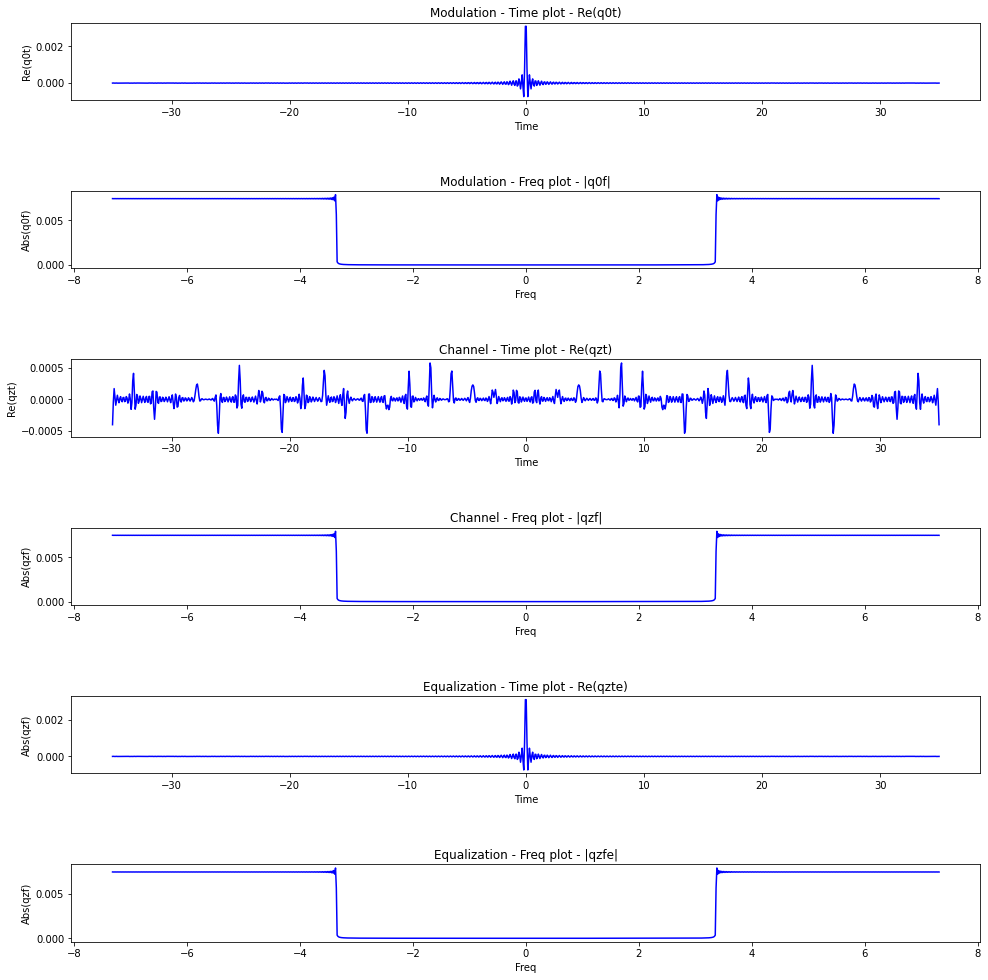

In [32]:
test_dataset(X, parameters, 1)

[channel] qzt : [8.49179606e-08-1.11262990e-08j 7.82113363e-07+5.65015072e-06j
 1.46270637e-06+1.03760807e-05j ... 1.46272429e-06+1.03760783e-05j
 7.82096642e-07+5.65015881e-06j 8.49073951e-08-1.11204605e-08j]
[channel] qzf : [ 0.00324465+0.02271259j -0.00315607-0.02258733j  0.0031052 +0.02273214j
 ... -0.0034329 -0.02254679j  0.00338392+0.02269232j
 -0.0032946 -0.02256753j]
[Equalizer] qzte : [6.30273750e-11+3.86374246e-11j 8.06796376e-07+5.64780381e-06j
 1.48183809e-06+1.03729574e-05j ... 1.48185576e-06+1.03729536e-05j
 8.06779906e-07+5.64781289e-06j 5.25844209e-11+4.44482487e-11j]
[Equalizer] qzfe : [ 0.00324465+0.02271259j -0.00315608-0.02258732j  0.00310524+0.02273213j
 ... -0.003433  -0.02254677j  0.00338396+0.02269231j
 -0.00329461-0.02256753j]


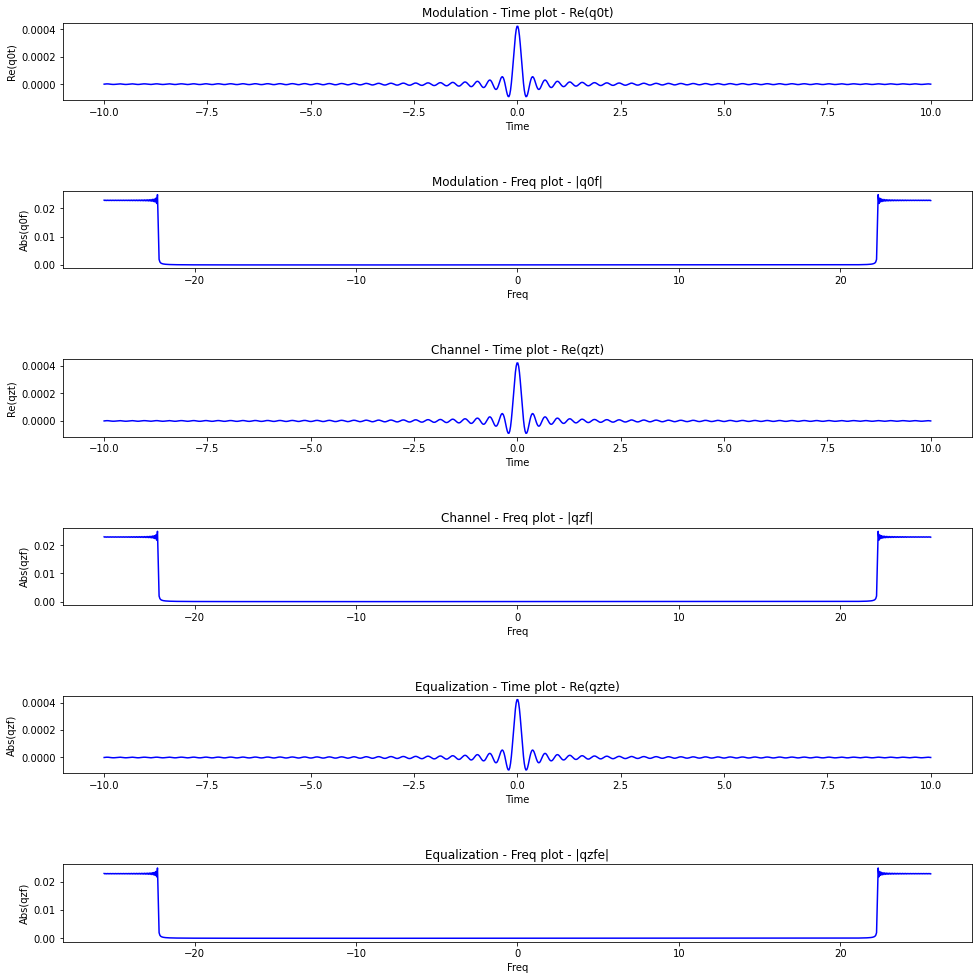

In [126]:
test_dataset(X, parameters, 50)

In [14]:
df = pd.read_csv("df_30K.csv")

In [15]:
df.head()

,Unnamed: 0,0,1,2,3,4,5,6,7,8,...,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
0,0,0.534154,0.480307,0.562815,0.583711,0.562814,0.583710,0.562814,0.583710,0.562814,...,0.545348,0.475504,0.545348,0.475504,0.545348,0.475504,0.545348,0.475504,0.545348,0.475504
1,1,0.501039,0.501073,0.547738,0.502263,0.547739,0.502262,0.547739,0.502263,0.547739,...,0.508301,0.492754,0.508301,0.492754,0.508301,0.492754,0.508301,0.492754,0.508301,0.492754
2,2,0.539968,0.438700,0.427135,0.488688,0.427136,0.488688,0.427136,0.488688,0.427136,...,0.557769,0.434166,0.557769,0.434166,0.557769,0.434166,0.557769,0.434166,0.557769,0.434166
3,3,0.442539,0.435230,0.396985,0.542987,0.396985,0.542986,0.396985,0.542986,0.396985,...,0.458835,0.419765,0.458835,0.419765,0.458835,0.419765,0.458835,0.419765,0.458835,0.419765
4,4,0.742763,0.472303,0.698492,0.457014,0.698492,0.457013,0.698493,0.457014,0.698493,...,0.759585,0.490765,0.759585,0.490765,0.759585,0.490765,0.759585,0.490765,0.759585,0.490765


In [16]:
df = df.drop(columns=df.columns[0])

In [17]:
df.shape

(30000, 4096)

In [18]:
withReshape = True
ts = 0.2
X_train, X_test, y_train, y_test = prepareTrainAndTestData(df, withReshape, ts)

[INFO] - {prepareTrainAndTestData} converting from pandas to numpy...
(30000, 2048)
(30000, 2048)
(24000, 2048, 1)
(24000, 2048, 1)
(6000, 2048, 1)
(6000, 2048, 1)


In [19]:
X_test[0:1,:2048].shape

(1, 2048, 1)

# **Model Training & Testing**

In [20]:
import datetime

In [21]:
import tensorflow as tf

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Embedding, BatchNormalization, Conv1D, Conv2D, Dense, LSTM, Flatten, Dropout
from tensorflow.keras.layers import LeakyReLU
from keras.callbacks import History 
from keras.utils.vis_utils import plot_model

from tensorflow.keras.layers import Activation
from tensorflow.keras.utils import get_custom_objects
from keras import backend as K
from keras.optimizers import Adam

Using TensorFlow backend.


In [35]:
#-----------------------------------------------------------------------------------------------------#

def train(model, X_train, X_test, y_train, y_test, Nepochs, batchSize) :
  # Fiting the model
  log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
  tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
  
  model.fit( X_train, y_train, 
            batch_size = batchSize, 
            epochs = Nepochs, 
            verbose = 1, 
            validation_data =(X_test, y_test), 
            callbacks =[history, tensorboard_callback])
  
  return model

#-----------------------------------------------------------------------------------------------------#

def test_model(model, X_test, y_test, history, index_pred, with_error_plots) :
  with_eval = False
  y_pred = evaluate(model, X_test, y_test, history, index_pred, with_eval, with_error_plots)
  return y_pred

#-----------------------------------------------------------------------------------------------------#


def evaluate(model, X_test, y_test, history, index_pred, with_eval, with_error_plots):

  # evaluating and printing results 
  if with_eval :
    score = model.evaluate(X_test, y_test, verbose = 0) 
    print('Test loss:', score[0]) 
    print('Test accuracy:', score[1]) 

  # Plots
  
  if with_error_plots : 
    plt.plot(history.history['mean_squared_error'])
    plt.title("mean_squared_error")
    plt.show()
    plt.plot(history.history['mean_absolute_error'])
    plt.title("mean_absolute_error")
    plt.show()
    plt.plot(history.history['mean_absolute_percentage_error']) 
    plt.title("mean_absolute_percentage_error")
    plt.show()
    plt.plot(history.history['cosine_proximity'])
    plt.title("cosine_proximity")
    plt.show()
    plt.plot(history.history['msle'])
    plt.title("msle")
    plt.show()
    
  # prediction on one element
  X = X_test[index_pred]
  y_pred = model.predict(X)
  print("X_test.shape : ",X_test.shape)
  print("y_test.shape : ",y_test.shape)
  print("X.shape : ",X.shape)
  print("y_pred.shape : ",y_pred.shape)
  print("After reshaping...")
  X = X.reshape(-1,1)
  y_pred = y_pred.reshape(-1,1)
  print("X.shape : ",X.shape)
  print("y_pred.shape : ",y_pred.shape)

  X_im = fromRealToComplex(X.T)
  y_im = fromRealToComplex(y_pred.T)

  y_qzt, y_qzf = channel.channel(parameters.t, X_im, parameters.z, parameters.sigma02, parameters.B)
  y_gen_equalized_t, y_gen_equalized_f = equalizer.equalize(parameters.t, y_im, parameters.z)
  y_qzt_equalized_t, y_qzt_equalized_f = equalizer.equalize(parameters.t, y_qzt, parameters.z)

  allPlots(y_qzt, y_qzf, y_qzt_equalized_t, y_qzt_equalized_f, y_im, y_gen_equalized_t, y_gen_equalized_f)

  return y_pred

#-----------------------------------------------------------------------------------------------------#

def allPlots(y_qzt, y_qzf, y_qzt_equalized_t, y_qzt_equalized_f, y_pred, y_pred_equalized_t, y_pred_equalized_f):
    
    fig2, (ax1, ax2, ax3, ax4, ax5, ax6, ax7) = plt.subplots(7, figsize = (15, 15))
    fig2.tight_layout(pad=7.0)


    ###
    ax1.plot(parameters.t, np.squeeze(y_qzt.real), 'b-')
    ax1.set_xlabel("Time")
    ax1.set_ylabel("Abs(y_qzt)")
    ax1.set_title("y_test passed in Channel function - Time plot - Re(y_qzt)")

    ###
    ax2.plot(parameters.f, np.squeeze(np.abs(y_qzf)), 'b-')
    ax2.set_xlabel("Freq")
    ax2.set_ylabel("Abs(y_qzf)")
    ax2.set_title("Equalization of y_test- Freq plot - |y_qzf|")

    ###
    ax3.plot(parameters.t, np.squeeze(np.abs(y_qzt_equalized_t)), 'b-')
    ax3.set_xlabel("Time")
    ax3.set_ylabel("Abs(y_qzt_equalized_t)")
    ax3.set_title("Equalization of y_test input in the Channel - Time plot - |y_qzt_equalized_t|")

    ###
    ax4.plot(parameters.f, np.squeeze(np.abs(y_qzt_equalized_f)), 'b-')
    ax4.set_xlabel("Freq")
    ax4.set_ylabel("Abs(y_qzt_equalized_f)")
    ax4.set_title("Equalization of y_test input in the Channel - Freq plot - |y_qzt_equalized_f|")

    ###
    ax5.plot(parameters.t, np.squeeze(np.absolute(y_pred)), 'r-')
    ax5.set_xlabel("Time")
    ax5.set_ylabel("Abs(y_pred)")
    ax5.set_title("Prediction (y_pred) - Time plot - |y_pred|")

    ###
    ax6.plot(parameters.t, np.squeeze(np.abs(y_pred_equalized_t)), 'r-')
    ax6.set_xlabel("Time")
    ax6.set_ylabel("Abs(y_pred_equalized_t)")
    ax6.set_title("Equalization of prediction (y_pred) - Time plot - |y_pred_equalized_t|")

    ###        
    ax7.plot(parameters.f, np.squeeze(np.abs(y_pred_equalized_f)), 'r-')
    ax7.set_xlabel("Freq")
    ax7.set_ylabel("Abs(y_pred_equalized_t)")
    ax7.set_title("Equalization of prediction (y_pred) - Freq plot - |y_pred_equalized_f|")

    plt.show()

#-----------------------------------------------------------------------------------------------------#

def all_evals(model, index_pred):

  with_error_plots = False
  with_eval = False
  y_pred = evaluate(model, X_test, y_test, history, index_pred, with_eval, with_error_plots)

  X_test_im = goBackToComplexVector(X_test[index_pred])
  y_test_im = goBackToComplexVector(y_test[index_pred])
  y_pred_im = goBackToComplexVector(y_pred)

  plotOne(X_test_im)
  plotTwo(X_test_im, y_pred_im)
  plotTwo(y_test_im, y_pred_im)


#-----------------------------------------------------------------------------------------------------#

def plotResults(X, y_pred):

    y_pred_im = fromRealToComplex(y_pred.T).T
    X = fromRealToComplex(X.T).T

    Xf = np.fft.fftshift(X)
    Yf = np.fft.fftshift(y_pred_im)

    fig3, (ax5) = plt.subplots(1, figsize = (10, 10))
    fig3.tight_layout(pad=7.0)

    ###
    ax5.plot(parameters.f, np.absolute(Xf), 'b-', label='nnet')
    ax5.set_xlabel("Time")
    ax5.set_ylabel("Abs(y_gen)")
    ax5.set_title("NNetGen - Time plot - |y_gen|")

    ###
    ax5.plot(parameters.f, np.squeeze(np.absolute(Yf)), 'r-', label='nnet')
    ax5.set_xlabel("Freq")
    ax5.set_ylabel("Abs(y_gen)")
    ax5.set_title("NNetGen - Freq plot - |y_gen|")

#-----------------------------------------------------------------------------------------------------#

In [23]:
history = History()
batch_size = 64
N_features = len(X_train[0])
N_samples = len(X_train)
N_output = len(y_train[0])
inputShape = (batch_size, N_features, 1)#(N_samples, batch_size, N_features) 
inputShape

(64, 2048, 1)

In [24]:
X_train.shape

(24000, 2048, 1)

In [25]:
X_train.shape[1]

2048

## **Dense (MLP)**

In [26]:
#-----------------------------------------------------------------------------------------------------#

def my_activation(x):
        """ Computes the activation of a neuron.
            @param x : data.

            Should use Keras function for stability of the tensors.
        """
        dz = parameters.z/parameters.nz
        return x*K.exp(dz*K.abs(x)**2)

#-----------------------------------------------------------------------------------------------------#

def create_MLP_CNN(only_dense, customActivationFct, lr, loss_fct, nbrOfStackedDense, nbrOfStackedCNN, nbrNeuronsDense, nbrFiltersCNN, dropoutDense, dropoutCNN):

  if lr != None :
    K.set_value(model_dense.optimizer.learning_rate, lr)

  # custom activation function
  if customActivationFct :
    get_custom_objects().update({'my_activation': Activation(my_activation)})
  
  # Model
  model_dense_cnn = Sequential()

  # Embedding layer -----------------------------------------------------------------------------------------------------#
  
  #model_dense_cnn.add(Embedding(X_train.shape[1], 16, input_length=X_train.shape[1]))
  
  # Fully connected layers -----------------------------------------------------------------------------------------------#

  # Input layer - 1st Dense layer should include input shape
  model_dense_cnn.add(Dense(64, kernel_initializer='normal', input_shape=X_train.shape[1:]))
  model_dense_cnn.add(LeakyReLU())
  model_dense_cnn.add(Dropout(dropoutDense))
  model_dense_cnn.add(BatchNormalization())

  
  for i in range(nbrOfStackedDense) :
    model_dense_cnn.add(Dense(nbrNeuronsDense, kernel_initializer='normal'))
    model_dense_cnn.add(LeakyReLU())
    model_dense_cnn.add(Dropout(dropoutDense))
    model_dense_cnn.add(BatchNormalization())

  

  # Convolution layers ----------------------------------------------------------------------------------------------------#
  if only_dense != 1 :

    # 1st CNN layer should include input shape
    model_dense_cnn.add(Conv1D(filters=nbrFiltersCNN, kernel_size=1 ,strides=1, input_shape=X_train.shape[1:], kernel_initializer= 'uniform')) 
    model_dense_cnn.add(LeakyReLU())
    model_dense_cnn.add(Dropout(dropoutCNN))
    model_dense_cnn.add(BatchNormalization())


    # go up to 10 layers of CNN
    for i in range(nbrOfStackedCNN-1):
      
      model_dense_cnn.add(Conv1D(filters=nbrFiltersCNN, kernel_size=1 ,strides=1,  kernel_initializer= 'uniform', activation='sigmoid'))
      model_dense_cnn.add(Dropout(dropoutCNN))
      model_dense_cnn.add(BatchNormalization())

   

  # Fully connected layers -------------------------------------------------------------------------------------------------#
  for i in range(nbrOfStackedDense) :
    model_dense_cnn.add(Dense(nbrNeuronsDense, kernel_initializer='normal'))
    model_dense_cnn.add(LeakyReLU())
    model_dense_cnn.add(Dropout(dropoutDense))
    model_dense_cnn.add(BatchNormalization())

  

  # Output layer -----------------------------------------------------------------------------------------------------------#
  model_dense_cnn.add(Dense(1))
  if customActivationFct :
    model_dense_cnn.add(Activation(my_activation, name='SpecialActivation'))
  else :
    model_dense_cnn.add(Activation('sigmoid'))

  # Compile the model ------------------------------------------------------------------------------------------------------#
  model_dense_cnn.compile(loss=loss_fct, 
                      optimizer='adam', 
                      metrics=['mean_squared_error', 'mean_absolute_error', 'mean_absolute_percentage_error', 'cosine_proximity', 'msle'])
  
  print(model_dense_cnn.optimizer.get_config())
  print(model_dense_cnn.summary())
  print("model_dense.output_shape : ",model_dense_cnn.output_shape)

  return model_dense_cnn

#-----------------------------------------------------------------------------------------------------#

In [27]:
with_error_plots = True 

only_dense = True
customActivationFct = False
lr = None

nbrOfStackedDense = 3
nbrOfStackedCNN = 4
nbrNeuronsDense = 32
nbrFiltersCNN = 32

dropoutDense, dropoutCNN = 0.25, 0.15

loss_fct = 'mse'

model_dense_cnn = create_MLP_CNN(only_dense, customActivationFct, lr, loss_fct, nbrOfStackedDense, nbrOfStackedCNN, nbrNeuronsDense, nbrFiltersCNN, dropoutDense, dropoutCNN)

{'name': 'Adam', 'learning_rate': 0.001, 'decay': 0.0, 'beta_1': 0.9, 'beta_2': 0.999, 'epsilon': 1e-07, 'amsgrad': False}
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2048, 64)          128       
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 2048, 64)          0         
_________________________________________________________________
dropout (Dropout)            (None, 2048, 64)          0         
_________________________________________________________________
batch_normalization (BatchNo (None, 2048, 64)          256       
_________________________________________________________________
dense_1 (Dense)              (None, 2048, 32)          2080      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 2048, 32)          0         

In [28]:
epochs = 5
# Fiting the model
model_dense_cnn = train(model_dense_cnn, X_train, X_test, y_train, y_test, epochs , batch_size)

Epoch 1/5
375/375 [==============================] - 799s 2s/step - loss: 0.0220 - mean_squared_error: 0.0220 - mean_absolute_error: 0.1108 - mean_absolute_percentage_error: 7086.8445 - cosine_proximity: 0.9999 - msle: 0.0101 - val_loss: 0.0137 - val_mean_squared_error: 0.0137 - val_mean_absolute_error: 0.0931 - val_mean_absolute_percentage_error: 21.4909 - val_cosine_proximity: 1.0000 - val_msle: 0.0062
Epoch 2/5
375/375 [==============================] - 739s 2s/step - loss: 0.0140 - mean_squared_error: 0.0140 - mean_absolute_error: 0.0932 - mean_absolute_percentage_error: 17500.7121 - cosine_proximity: 0.9999 - msle: 0.0064 - val_loss: 0.0135 - val_mean_squared_error: 0.0135 - val_mean_absolute_error: 0.0922 - val_mean_absolute_percentage_error: 21.9166 - val_cosine_proximity: 1.0000 - val_msle: 0.0062
Epoch 3/5
375/375 [==============================] - 734s 2s/step - loss: 0.0138 - mean_squared_error: 0.0138 - mean_absolute_error: 0.0922 - mean_absolute_percentage_error: 10546.945

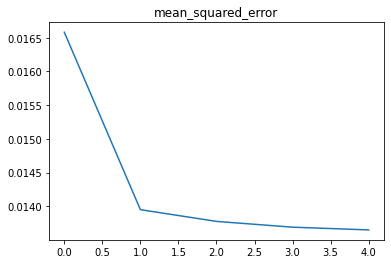

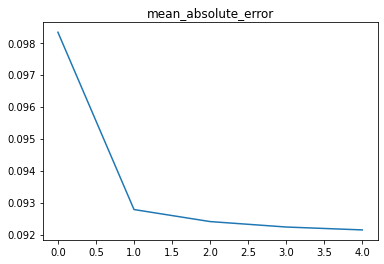

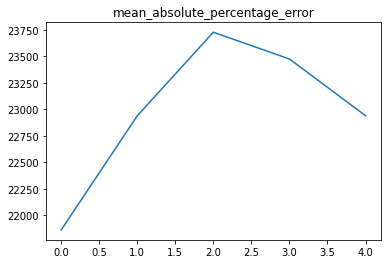

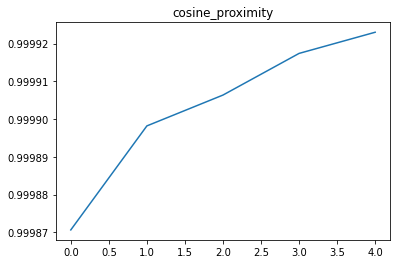

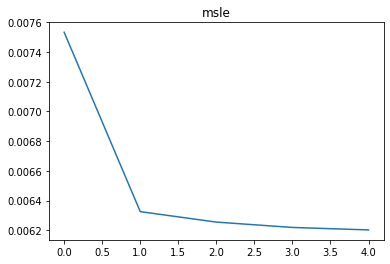

X_test.shape :  (6000, 2048, 1)
y_test.shape :  (6000, 2048, 1)
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1, 1)
After reshaping...
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024)
{fromRealToComplex} vect_im.shape :  (1, 1024)
[channel] qzt : [[0.51285879+0.43492371j 0.4995799 +0.56064676j 0.50318972+0.56126464j
  ... 0.50258205+0.56092476j 0.50173714+0.56171486j
  0.47981253+0.50051919j]]
[channel] qzf : [[ 5.12024748e+02+5.12790822e+02j -2.26105985e-02-3.80483662e-01j
   1.28700367e-02+6.06953744e-01j ... -1.38331274e-02-1.31937907e-01j
   2.12656047e-02+6.07100151e-01j -2.43941581e-02-3.80134486e-01j]]
[Equalizer] qzte : [[0.49169299+0.4919572j  0.49168947+0.49193596j 0.49169247+0.49193607j
  ... 0.49168994+0.49193604j 0.49169817+0.4919365j
  0.49170789+0.49169152j]]
[Equalizer] qzfe : [[ 5.03494778e+02+5.03735979e+02j  3.07042151e-05-2.42030074e-04j
  -8.37580157e-06-1.41746174e-04j ...  1.42546538e-05-2.17696200e-04j
  -1.39752599e-05

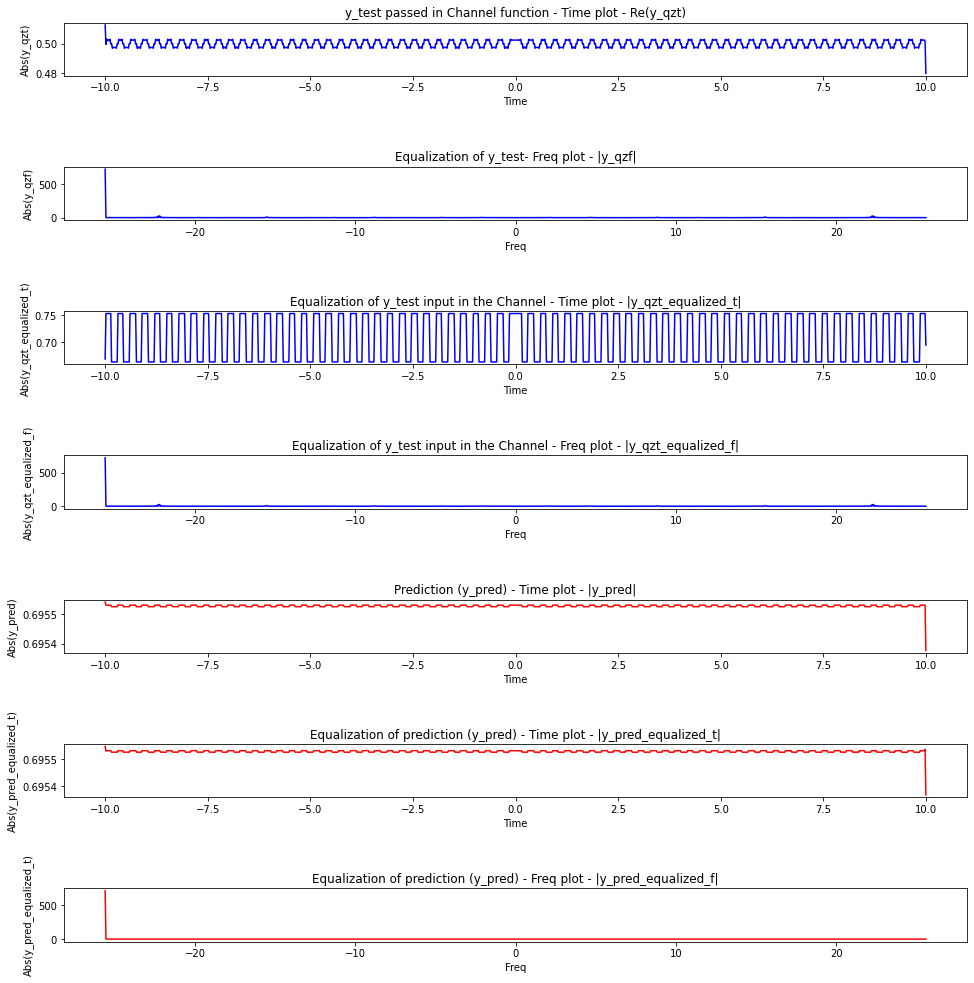

In [36]:
# testing the model
index_pred = 1
with_error_plots = True
y_pred = test_model(model_dense_cnn, X_test, y_test, history, index_pred, with_error_plots)

In [ ]:
with_error_plots = True 

only_dense = True
customActivationFct = False
lr = None

nbrOfStackedDense = 3
nbrOfStackedCNN = 5
nbrNeuronsDense = 64
nbrFiltersCNN = 64

dropoutDense, dropoutCNN = 0.15, 0.15

loss_fct = 'mse'

model_dense = create_MLP_CNN(only_dense, customActivationFct, lr, loss_fct, nbrOfStackedDense, nbrOfStackedCNN, nbrNeuronsDense, nbrFiltersCNN, dropoutDense, dropoutCNN)

{'name': 'Adam', 'learning_rate': 0.001, 'decay': 0.0, 'beta_1': 0.9, 'beta_2': 0.999, 'epsilon': 1e-07, 'amsgrad': False}
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 1500, 64)          128       
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 1500, 64)          0         
_________________________________________________________________
dropout (Dropout)            (None, 1500, 64)          0         
_________________________________________________________________
batch_normalization (BatchNo (None, 1500, 64)          256       
_________________________________________________________________
dense_1 (Dense)              (None, 1500, 64)          4160      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 1500, 64)          0         

In [ ]:
epochs = 55
# Fiting the model
model_dense = train(model_dense, X_train, X_test, y_train, y_test, epochs , batch_size)

Epoch 1/55
469/469 [==============================] - 18s 38ms/step - loss: 0.2475 - mean_squared_error: 0.2475 - mean_absolute_error: 0.4946 - mean_absolute_percentage_error: 142199792.0000 - cosine_proximity: 0.6881 - msle: 0.1223 - val_loss: 0.2467 - val_mean_squared_error: 0.2467 - val_mean_absolute_error: 0.4931 - val_mean_absolute_percentage_error: 140820736.0000 - val_cosine_proximity: 0.6880 - val_msle: 0.1215
Epoch 2/55
469/469 [==============================] - 18s 37ms/step - loss: 0.2470 - mean_squared_error: 0.2470 - mean_absolute_error: 0.4935 - mean_absolute_percentage_error: 142086368.0000 - cosine_proximity: 0.6881 - msle: 0.1221 - val_loss: 0.2461 - val_mean_squared_error: 0.2461 - val_mean_absolute_error: 0.4930 - val_mean_absolute_percentage_error: 141900864.0000 - val_cosine_proximity: 0.6880 - val_msle: 0.1218
Epoch 3/55
469/469 [==============================] - 18s 37ms/step - loss: 0.2464 - mean_squared_error: 0.2464 - mean_absolute_error: 0.4925 - mean_absolut

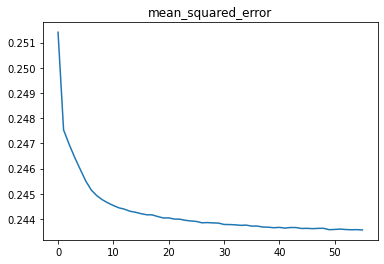

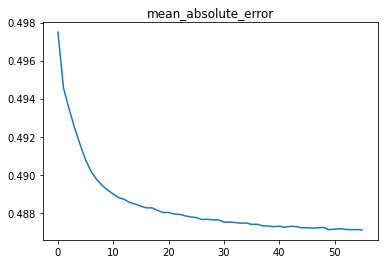

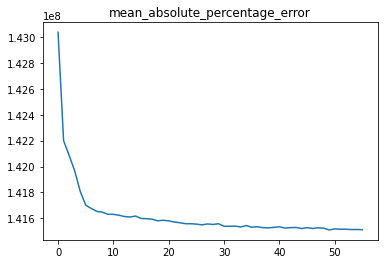

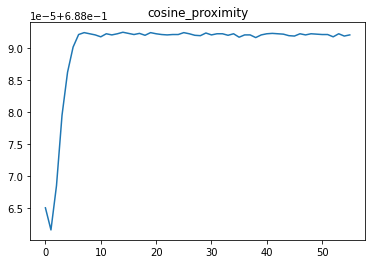

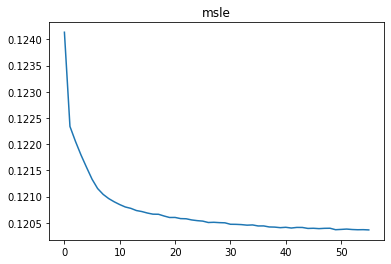

X_test.shape :  (10000, 1500, 1)
y_test.shape :  (10000, 1500, 1)
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1, 1)
After reshaping...
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1)
{fromRealToComplex} vect_im.shape :  (1, 750)
{fromRealToComplex} vect_im.shape :  (1, 750)
[channel] qzt : [[ 5.14537068e-01+2.66219635e-01j -1.06614302e-01+5.61374909e-01j
   4.45955252e-01+6.28453247e-01j  2.62848505e-01+7.03914640e-01j
   5.12281935e-01+9.48706748e-01j -1.26308989e-01-5.14120161e-02j
  -1.28234528e-01+4.53183884e-01j -1.92490823e-01+1.12102747e+00j
  -5.28126035e-01+8.22673958e-01j  3.91619626e-01+8.09660457e-01j
   5.91216187e-01+1.02384213e+00j  4.73906673e-01+2.32851642e-01j
  -9.02074508e-02+6.13133092e-01j  4.55383741e-01+1.39162992e-01j
  -5.08670884e-01+1.04320200e+00j  5.12573390e-01+7.87222636e-01j
   3.52768987e-01+6.21673305e-01j  7.63582921e-01+5.96759549e-01j
   2.24500198e-01+2.50248939e-01j  4.52955271e-01-4.00555058e-01j
   5.98335171e-01+1.68247922e-02j  3.93274571e-02+

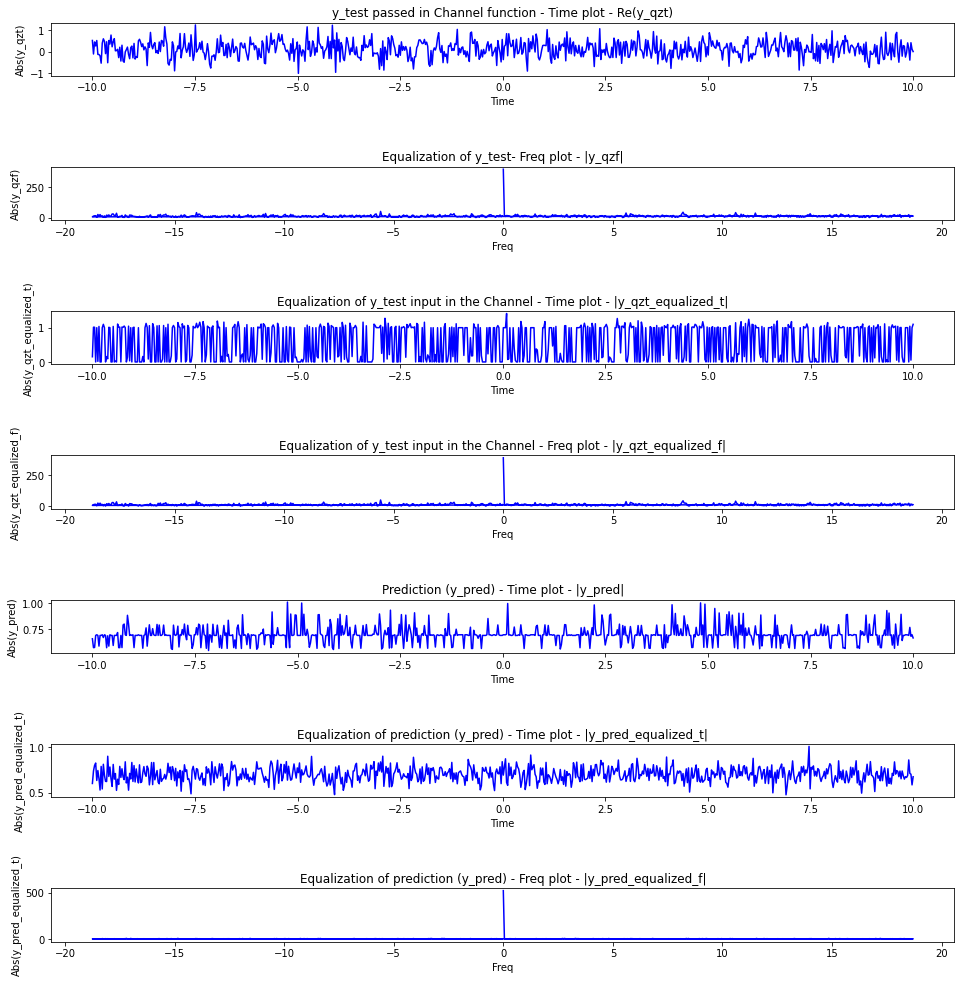

In [ ]:
# testing the model
index_pred = -1
with_error_plots = True
y_pred = test_model(model_dense, X_test, y_test, history, index_pred, with_error_plots)

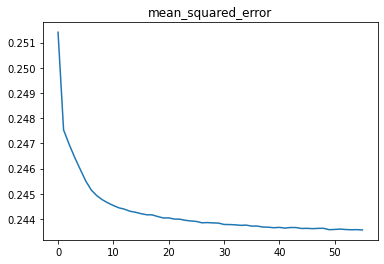

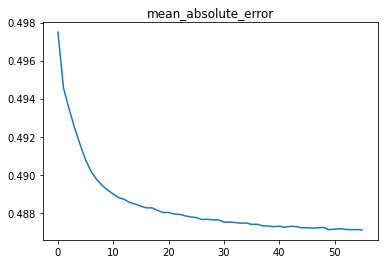

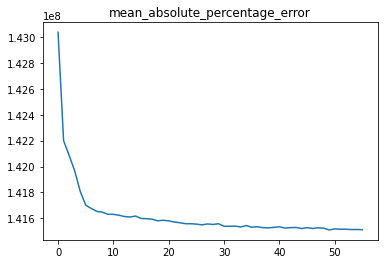

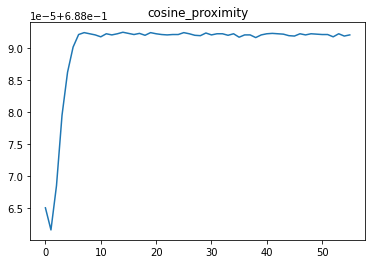

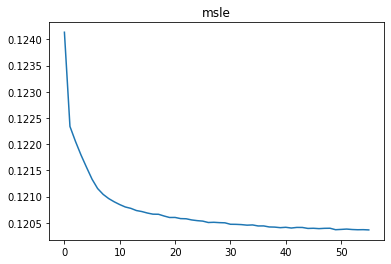

X_test.shape :  (10000, 1500, 1)
y_test.shape :  (10000, 1500, 1)
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1, 1)
After reshaping...
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1)
{fromRealToComplex} vect_im.shape :  (1, 750)
{fromRealToComplex} vect_im.shape :  (1, 750)
[channel] qzt : [[ 5.14537068e-01+2.66219635e-01j -1.06614302e-01+5.61374909e-01j
   4.45955252e-01+6.28453247e-01j  2.62848505e-01+7.03914640e-01j
   5.12281935e-01+9.48706748e-01j -1.26308989e-01-5.14120161e-02j
  -1.28234528e-01+4.53183884e-01j -1.92490823e-01+1.12102747e+00j
  -5.28126035e-01+8.22673958e-01j  3.91619626e-01+8.09660457e-01j
   5.91216187e-01+1.02384213e+00j  4.73906673e-01+2.32851642e-01j
  -9.02074508e-02+6.13133092e-01j  4.55383741e-01+1.39162992e-01j
  -5.08670884e-01+1.04320200e+00j  5.12573390e-01+7.87222636e-01j
   3.52768987e-01+6.21673305e-01j  7.63582921e-01+5.96759549e-01j
   2.24500198e-01+2.50248939e-01j  4.52955271e-01-4.00555058e-01j
   5.98335171e-01+1.68247922e-02j  3.93274571e-02+

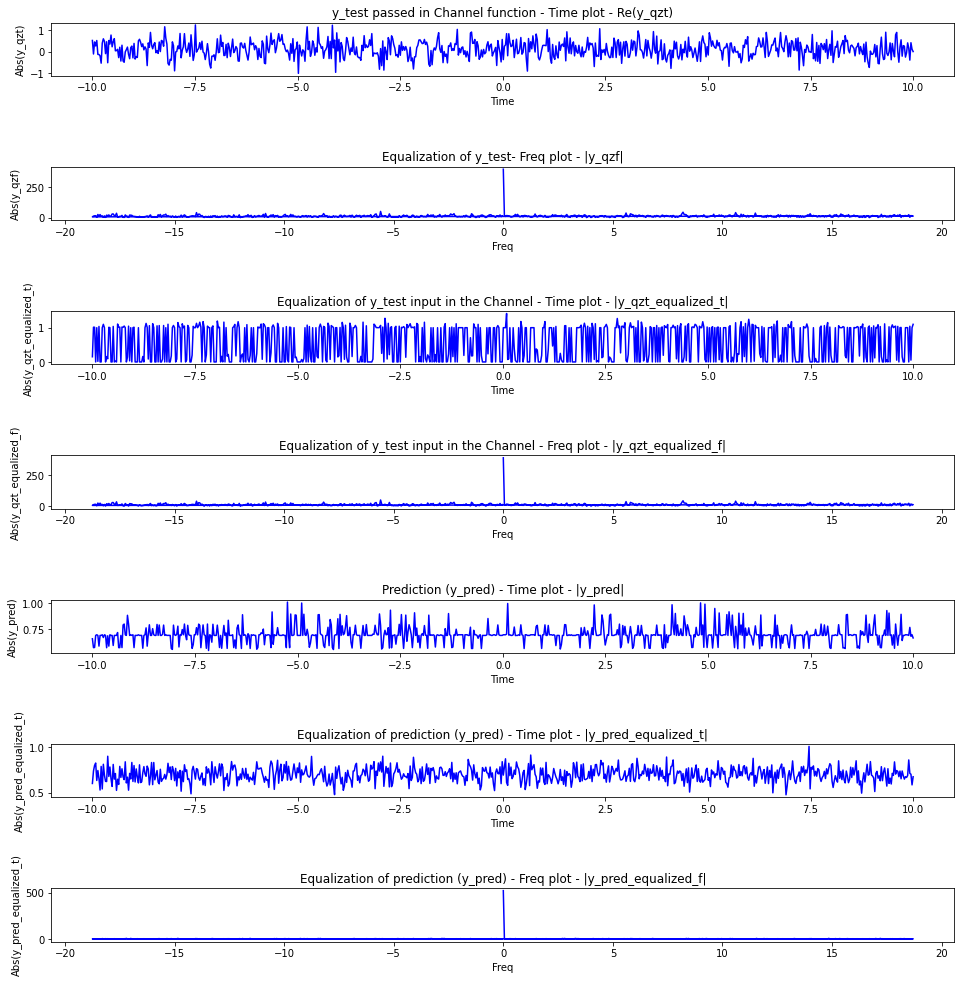

In [ ]:
# testing the model
index_pred = 100
with_error_plots = True
y_pred = test_model(model_dense, X_test, y_test, history, index_pred, with_error_plots)

## **CNN-1D**

In [ ]:
#-----------------------------------------------------------------------------------------------------#

def my_activation(x):
        """ Computes the activation of a neuron.
            @param x : data.

            Should use Keras function for stability of the tensors.
        """
        dz = parameters.z/parameters.nz
        return x*K.exp(dz*K.abs(x)**2)

#-----------------------------------------------------------------------------------------------------#

def create_CNN1D(only_dense, customActivationFct, lr, loss_fct, nbrOfStackedCNN, nbrFiltersCNN, dropoutDense, dropoutCNN):

  if lr != None :
    K.set_value(model_dense.optimizer.learning_rate, lr)

  # custom activation function
  if customActivationFct :
    get_custom_objects().update({'my_activation': Activation(my_activation)})
  
  # Model
  model_cnn1D= Sequential()

  # Convolution layers


  # 1st CNN layer should include input shape
  model_cnn1D.add(Conv1D(filters=nbrFiltersCNN, kernel_size=1 ,strides=1, input_shape=X_train.shape[1:], kernel_initializer= 'uniform')) 
  model_cnn1D.add(LeakyReLU())
  model_cnn1D.add(Dropout(dropoutCNN))

  # go up to 10 layers of CNN
  for i in range(nbrOfStackedCNN):
    
    model_cnn1D.add(Conv1D(filters=nbrFiltersCNN, kernel_size=1 ,strides=1,  kernel_initializer= 'uniform', activation='relu'))
    model_cnn1D.add(Dropout(dropoutCNN))

    

  # Fully connected layers
  for i in range(nbrOfStackedDense) :
    model_cnn1D.add(Dense(nbrNeuronsDense, kernel_initializer='normal', activation='relu'))
    model_cnn1D.add(Dropout(dropoutDense))
  

  # Output layer
  model_cnn1D.add(Dense(1))
  if customActivationFct :
    model_cnn1D.add(Activation(my_activation, name='SpecialActivation'))
  else :
    model_cnn1D.add(Activation('relu'))

  # Compile the model
  model_cnn1D.compile(loss=loss_fct, 
                      optimizer='adam', 
                      metrics=['mean_squared_error', 'mean_absolute_error', 'mean_absolute_percentage_error', 'cosine_proximity', 'msle'])
  
  print(model_cnn1D.optimizer.get_config())
  print(model_cnn1D.summary())
  print("model_dense.output_shape : ",model_cnn1D.output_shape)

  return model_cnn1D

#-----------------------------------------------------------------------------------------------------#

In [ ]:
X_train.shape[1:]

(1500, 1)

## **LSTM**

In [ ]:
inputs=inputShape

In [ ]:
#-----------------------------------------------------------------------------------------------------#

def create_LSTM(only_dense, customActivationFct, lr, loss_fct, nbrOfStackedLSTM, nbrOfStackedDense, nbrNeuronsLSTM, dropoutDense, dropoutLSTM):

  if lr != None :
    K.set_value(model_dense.optimizer.learning_rate, lr)

  # custom activation function
  if customActivationFct :
    get_custom_objects().update({'my_activation': Activation(my_activation)})

  # Model
  model_lstm = Sequential()

  # Input Layer
  #model_lstm.add(Input(shape=inputShape))
  # Input layer - 1st Dense layer should include input shape
  model_lstm.add(Dense(16, kernel_initializer='normal', input_shape=X_train.shape[1:]))
  model_lstm.add(LeakyReLU())
  model_lstm.add(Dropout(dropoutDense))
  model_lstm.add(BatchNormalization())

  # LSTM layers

  # 1st LSTM layer should include input shape
  model_lstm.add(LSTM(nbrNeuronsLSTM, return_sequences=True))
  model_lstm.add(LeakyReLU())
  model_lstm.add(Dropout(dropoutLSTM))
  model_lstm.add(BatchNormalization())

  # go up to 10 layers of LSTM
  for i in range(nbrOfStackedLSTM):    
    model_lstm.add(LSTM(nbrNeuronsLSTM, return_sequences=True))
    model_lstm.add(LeakyReLU())
    model_lstm.add(Dropout(dropoutLSTM))
    model_lstm.add(BatchNormalization())

    

  # Fully connected layers
  for i in range(nbrOfStackedDense) :
    model_lstm.add(Dense(nbrNeuronsDense, kernel_initializer='normal', activation='relu'))
    model_lstm.add(Dropout(dropoutDense))
    model_lstm.add(BatchNormalization())


  # Output layer
  model_lstm.add(Dense(1))
  if customActivationFct :
    model_lstm.add(Activation(my_activation, name='SpecialActivation'))
  else :
    model_lstm.add(Activation('sigmoid'))

  # Compile the model
  model_lstm.compile(loss=loss_fct, 
                      optimizer='adam', 
                      metrics=['mean_squared_error', 'mean_absolute_error', 'mean_absolute_percentage_error', 'cosine_proximity', 'msle'])

  print(model_lstm.optimizer.get_config())
  print(model_lstm.summary())
  print("model_dense.output_shape : ",model_lstm.output_shape)

  return model_lstm

  #-----------------------------------------------------------------------------------------------------#

In [ ]:
with_error_plots = True 

only_dense = False
customActivationFct = False
lr = None

nbrOfStackedDense = 6
nbrOfStackedLSTM = 4
nbrNeuronsDense = 32
nbrNeuronsLSTM = 32

dropoutDense, dropoutLSTM = 0.15, 0.15

loss_fct = 'mse'

model_lstm = create_LSTM(only_dense, customActivationFct, lr, loss_fct, nbrOfStackedLSTM, nbrOfStackedDense, nbrNeuronsLSTM, dropoutDense, dropoutLSTM)

{'name': 'Adam', 'learning_rate': 0.001, 'decay': 0.0, 'beta_1': 0.9, 'beta_2': 0.999, 'epsilon': 1e-07, 'amsgrad': False}
Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_135 (Dense)            (None, 1500, 16)          32        
_________________________________________________________________
leaky_re_lu_98 (LeakyReLU)   (None, 1500, 16)          0         
_________________________________________________________________
dropout_222 (Dropout)        (None, 1500, 16)          0         
_________________________________________________________________
batch_normalization_85 (Batc (None, 1500, 16)          64        
_________________________________________________________________
lstm_105 (LSTM)              (None, 1500, 32)          6272      
_________________________________________________________________
leaky_re_lu_99 (LeakyReLU)   (None, 1500, 32)          0      

In [ ]:
epochs = 5
# Fiting the model
model_lstm = train(model_lstm, X_train, X_test, y_train, y_test, epochs , batch_size)

Epoch 1/5
469/469 [==============================] - 163s 348ms/step - loss: 0.2147 - mean_squared_error: 0.2147 - mean_absolute_error: 0.4278 - mean_absolute_percentage_error: 122196624.0000 - cosine_proximity: 0.6878 - msle: 0.1060 - val_loss: 0.3069 - val_mean_squared_error: 0.3069 - val_mean_absolute_error: 0.5074 - val_mean_absolute_percentage_error: 140687408.0000 - val_cosine_proximity: 0.6881 - val_msle: 0.1496
Epoch 2/5
469/469 [==============================] - 159s 338ms/step - loss: 0.1106 - mean_squared_error: 0.1106 - mean_absolute_error: 0.2179 - mean_absolute_percentage_error: 63857092.0000 - cosine_proximity: 0.6866 - msle: 0.0543 - val_loss: 0.0422 - val_mean_squared_error: 0.0422 - val_mean_absolute_error: 0.1181 - val_mean_absolute_percentage_error: 36886240.0000 - val_cosine_proximity: 0.6881 - val_msle: 0.0218
Epoch 3/5
469/469 [==============================] - 159s 338ms/step - loss: 0.0613 - mean_squared_error: 0.0613 - mean_absolute_error: 0.1199 - mean_absolu

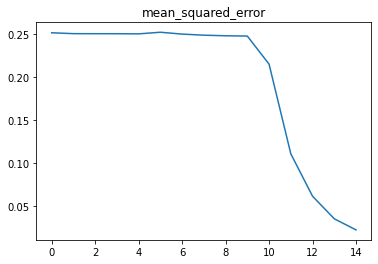

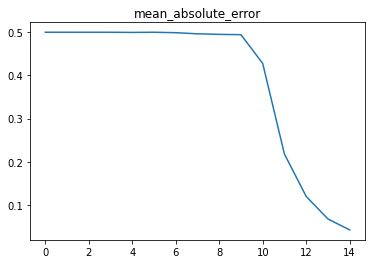

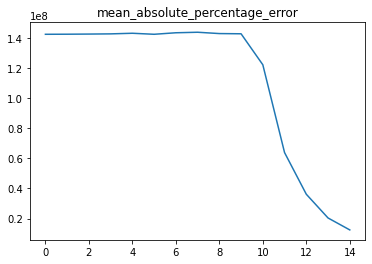

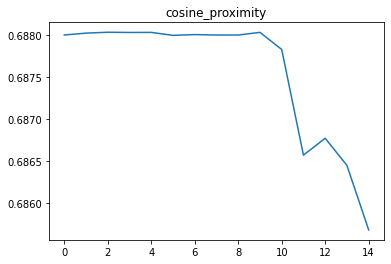

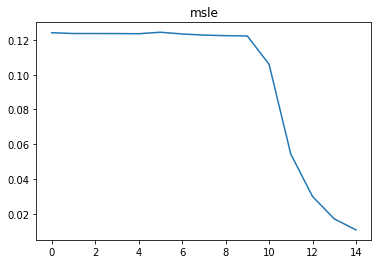

X_test.shape :  (10000, 1500, 1)
y_test.shape :  (10000, 1500, 1)
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1, 1)
After reshaping...
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1)
{fromRealToComplex} vect_im.shape :  (1, 750)
{fromRealToComplex} vect_im.shape :  (1, 750)
[channel] qzt : [[ 5.14537068e-01+2.66219635e-01j -1.06614302e-01+5.61374909e-01j
   4.45955252e-01+6.28453247e-01j  2.62848505e-01+7.03914640e-01j
   5.12281935e-01+9.48706748e-01j -1.26308989e-01-5.14120161e-02j
  -1.28234528e-01+4.53183884e-01j -1.92490823e-01+1.12102747e+00j
  -5.28126035e-01+8.22673958e-01j  3.91619626e-01+8.09660457e-01j
   5.91216187e-01+1.02384213e+00j  4.73906673e-01+2.32851642e-01j
  -9.02074508e-02+6.13133092e-01j  4.55383741e-01+1.39162992e-01j
  -5.08670884e-01+1.04320200e+00j  5.12573390e-01+7.87222636e-01j
   3.52768987e-01+6.21673305e-01j  7.63582921e-01+5.96759549e-01j
   2.24500198e-01+2.50248939e-01j  4.52955271e-01-4.00555058e-01j
   5.98335171e-01+1.68247922e-02j  3.93274571e-02+

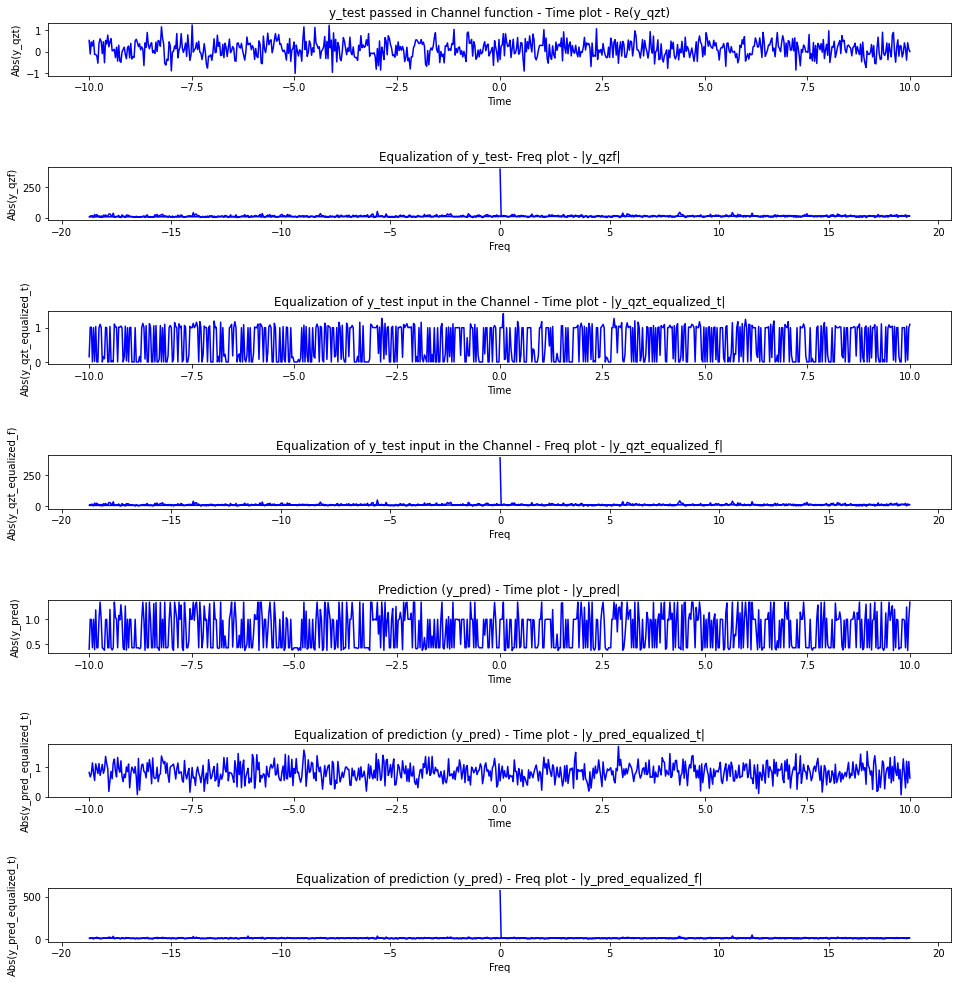

In [ ]:
# testing the model
index_pred = -1
with_error_plots = True
y_pred = test_model(model_lstm, X_test, y_test, history, index_pred, with_error_plots)

In [ ]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

## **LSTM-CNN**

In [ ]:
#-----------------------------------------------------------------------------------------------------#

def create_LSTM_CNN(customActivationFct, lr, loss_fct, nbrOfStackedLSTM, nbrOfStackedDense, nbrNeuronsLSTM, nbrOfStackedCNN, nbrFiltersCNN, dropoutDense, dropoutLSTM, dropoutCNN):

    # try RNN more beneficial
  if lr != None :
    K.set_value(model_dense.optimizer.learning_rate, lr)

  # custom activation function
  if customActivationFct :
    get_custom_objects().update({'my_activation': Activation(my_activation)})

  # Model
  model_lstm_cnn = Sequential()

  # Input Layer ----------------------------------------------------------------------------------------------------------#
  # 1st Dense layer should include input shape
  model_lstm_cnn.add(Dense(32, kernel_initializer='normal', input_shape=X_train.shape[1:]))
  model_lstm_cnn.add(LeakyReLU())
  model_lstm_cnn.add(Dropout(dropoutDense))
  model_lstm_cnn.add(BatchNormalization())

  # LSTM layers ----------------------------------------------------------------------------------------------------------#

  # 1st LSTM layer should include input shape
  model_lstm_cnn.add(LSTM(nbrNeuronsLSTM, return_sequences=True))
  model_lstm_cnn.add(LeakyReLU())
  model_lstm_cnn.add(Dropout(dropoutLSTM))
  model_lstm_cnn.add(BatchNormalization())

  # go up to 10 layers of LSTM
  for i in range(nbrOfStackedLSTM):    
    model_lstm_cnn.add(LSTM(nbrNeuronsLSTM, return_sequences=True))
    model_lstm_cnn.add(LeakyReLU())
    model_lstm_cnn.add(Dropout(dropoutLSTM))
    model_lstm_cnn.add(BatchNormalization())

  # Fully connected layers -------------------------------------------------------------------------------------------------#
  
  for i in range(nbrOfStackedDense) :
    model_lstm_cnn.add(Dense(nbrNeuronsDense, kernel_initializer='normal'))
    model_lstm_cnn.add(LeakyReLU())
    model_lstm_cnn.add(Dropout(dropoutDense))
    model_lstm_cnn.add(BatchNormalization())

  

  # Convolution layers ----------------------------------------------------------------------------------------------------#

  # 1st CNN layer should include input shape
  model_lstm_cnn.add(Conv1D(filters=nbrFiltersCNN, kernel_size=1 ,strides=1, input_shape=X_train.shape[1:], kernel_initializer= 'uniform')) 
  model_lstm_cnn.add(LeakyReLU())
  model_lstm_cnn.add(Dropout(dropoutCNN))

  # go up to 10 layers of CNN 
  for i in range(nbrOfStackedCNN-1):
    
    model_lstm_cnn.add(Conv1D(filters=nbrFiltersCNN, kernel_size=1 ,strides=1,  kernel_initializer= 'uniform', activation='sigmoid'))
    model_lstm_cnn.add(Dropout(dropoutCNN))

    

  # Fully connected layers -------------------------------------------------------------------------------------------------#
  for i in range(nbrOfStackedDense) :
    model_lstm_cnn.add(Dense(nbrNeuronsDense, kernel_initializer='normal'))
    model_lstm_cnn.add(LeakyReLU())
    model_lstm_cnn.add(Dropout(dropoutDense))
    model_lstm_cnn.add(BatchNormalization())
    


  # Output layer -----------------------------------------------------------------------------------------------------------#
  model_lstm.add(Dense(1))
  if customActivationFct :
    model_lstm_cnn.add(Activation(my_activation, name='SpecialActivation'))
  else :
    model_lstm_cnn.add(Activation('sigmoid'))

  # Compile the model
  model_lstm_cnn.compile(loss=loss_fct, 
                      optimizer='adam', 
                      metrics=['mean_squared_error', 'mean_absolute_error', 'mean_absolute_percentage_error', 'cosine_proximity', 'msle'])

  print(model_lstm_cnn.optimizer.get_config())
  print(model_lstm_cnn.summary())
  print("model_dense.output_shape : ",model_lstm_cnn.output_shape)

  return model_lstm

  #-----------------------------------------------------------------------------------------------------#

In [ ]:
customActivationFct, lr, loss_fct, nbrOfStackedLSTM, nbrOfStackedDense, nbrNeuronsLSTM, nbrOfStackedCNN, nbrFiltersCNN, dropoutDense, dropoutLSTM, dropoutCNN

In [ ]:
with_error_plots = True 

customActivationFct = False
lr = None

nbrOfStackedDense = 2
nbrOfStackedLSTM = 5
nbrOfStackedCNN = 5

nbrNeuronsDense = 32
nbrNeuronsLSTM = 32
nbrFiltersCNN = 32

dropoutDense, dropoutLSTM, dropoutCNN = 0.15, 0.15, 0.1

loss_fct = 'mse'

model_lstm_cnn = create_LSTM_CNN(customActivationFct, lr, loss_fct, nbrOfStackedLSTM, nbrOfStackedDense, nbrNeuronsLSTM, nbrOfStackedCNN, nbrFiltersCNN, dropoutDense, dropoutLSTM, dropoutCNN)

{'name': 'Adam', 'learning_rate': 0.001, 'decay': 0.0, 'beta_1': 0.9, 'beta_2': 0.999, 'epsilon': 1e-07, 'amsgrad': False}
Model: "sequential_22"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_143 (Dense)            (None, 1500, 32)          64        
_________________________________________________________________
leaky_re_lu_104 (LeakyReLU)  (None, 1500, 32)          0         
_________________________________________________________________
dropout_234 (Dropout)        (None, 1500, 32)          0         
_________________________________________________________________
batch_normalization_97 (Batc (None, 1500, 32)          128       
_________________________________________________________________
lstm_110 (LSTM)              (None, 1500, 32)          8320      
_________________________________________________________________
leaky_re_lu_105 (LeakyReLU)  (None, 1500, 32)          0      

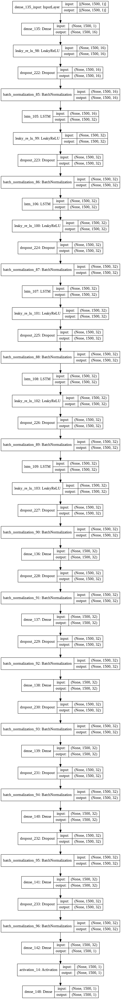

In [ ]:
plot_model(model_lstm_cnn, show_shapes=True, show_layer_names=True)

In [ ]:
epochs = 35
# Fiting the model
model_lstm = train(model_lstm_cnn, X_train, X_test, y_train, y_test, epochs , batch_size)

Epoch 1/35
469/469 [==============================] - 161s 343ms/step - loss: 0.0939 - mean_squared_error: 0.0939 - mean_absolute_error: 0.1841 - mean_absolute_percentage_error: 53119308.0000 - cosine_proximity: 0.6866 - msle: 0.0460 - val_loss: 0.0274 - val_mean_squared_error: 0.0274 - val_mean_absolute_error: 0.0948 - val_mean_absolute_percentage_error: 27757368.0000 - val_cosine_proximity: 0.6881 - val_msle: 0.0147
Epoch 2/35
469/469 [==============================] - 158s 337ms/step - loss: 0.0667 - mean_squared_error: 0.0667 - mean_absolute_error: 0.1294 - mean_absolute_percentage_error: 37883272.0000 - cosine_proximity: 0.6857 - msle: 0.0326 - val_loss: 0.0150 - val_mean_squared_error: 0.0150 - val_mean_absolute_error: 0.0595 - val_mean_absolute_percentage_error: 18437834.0000 - val_cosine_proximity: 0.6881 - val_msle: 0.0083
Epoch 3/35
469/469 [==============================] - 158s 338ms/step - loss: 0.0523 - mean_squared_error: 0.0523 - mean_absolute_error: 0.1007 - mean_absol

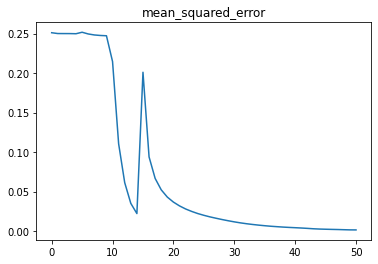

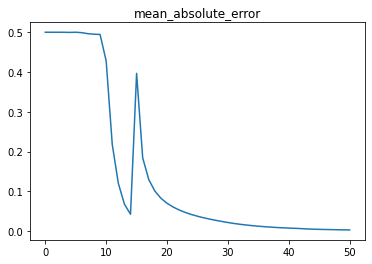

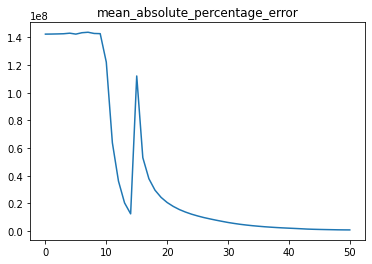

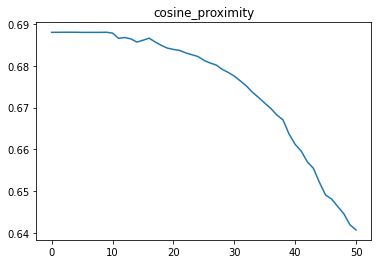

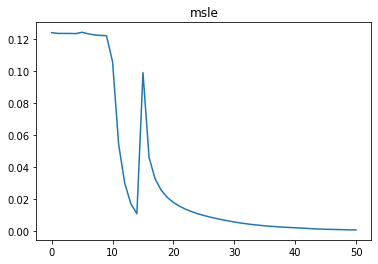

X_test.shape :  (10000, 1500, 1)
y_test.shape :  (10000, 1500, 1)
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1, 1)
After reshaping...
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1)
{fromRealToComplex} vect_im.shape :  (1, 750)
{fromRealToComplex} vect_im.shape :  (1, 750)
[channel] qzt : [[ 5.14537068e-01+2.66219635e-01j -1.06614302e-01+5.61374909e-01j
   4.45955252e-01+6.28453247e-01j  2.62848505e-01+7.03914640e-01j
   5.12281935e-01+9.48706748e-01j -1.26308989e-01-5.14120161e-02j
  -1.28234528e-01+4.53183884e-01j -1.92490823e-01+1.12102747e+00j
  -5.28126035e-01+8.22673958e-01j  3.91619626e-01+8.09660457e-01j
   5.91216187e-01+1.02384213e+00j  4.73906673e-01+2.32851642e-01j
  -9.02074508e-02+6.13133092e-01j  4.55383741e-01+1.39162992e-01j
  -5.08670884e-01+1.04320200e+00j  5.12573390e-01+7.87222636e-01j
   3.52768987e-01+6.21673305e-01j  7.63582921e-01+5.96759549e-01j
   2.24500198e-01+2.50248939e-01j  4.52955271e-01-4.00555058e-01j
   5.98335171e-01+1.68247922e-02j  3.93274571e-02+

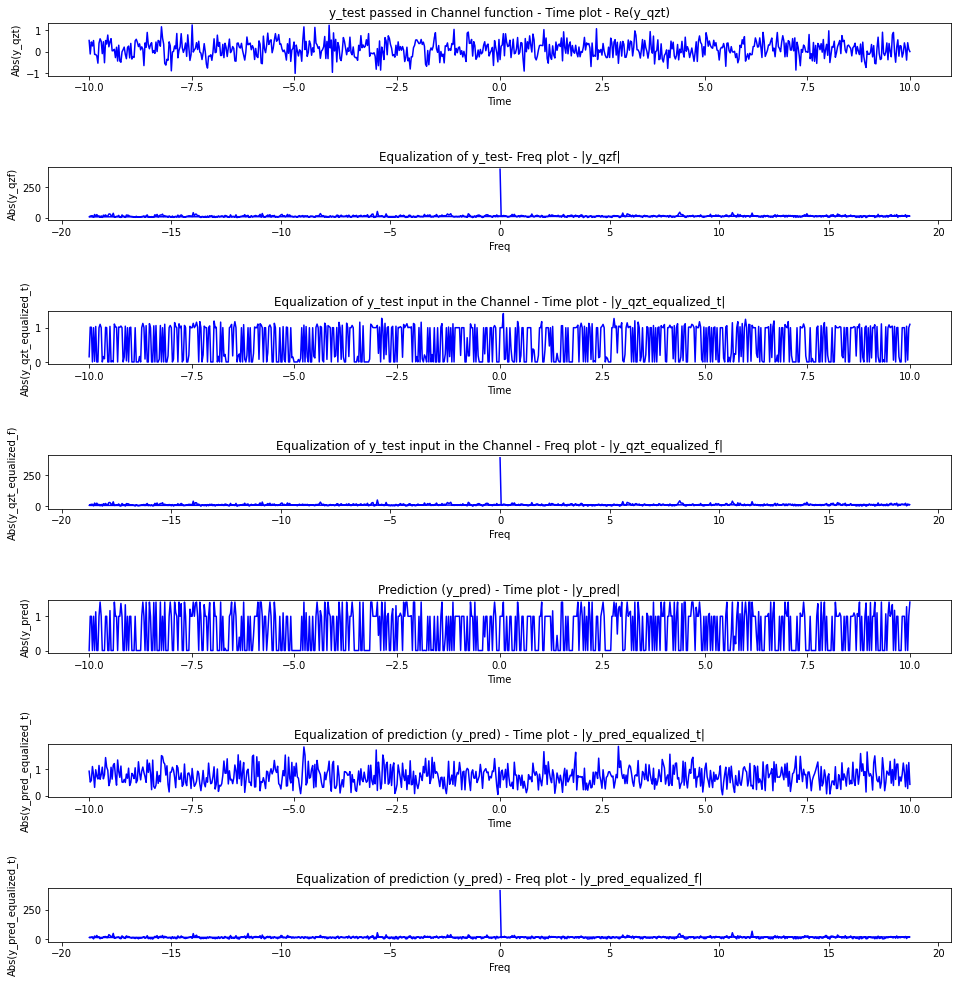

In [ ]:
# testing the model
index_pred = -1
with_error_plots = True
y_pred = test_model(model_lstm, X_test, y_test, history, index_pred, with_error_plots)

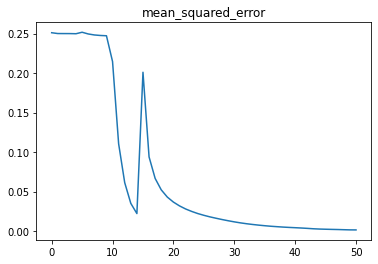

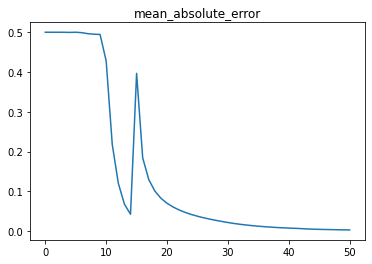

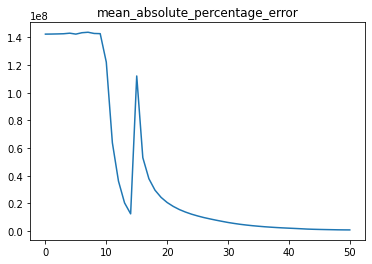

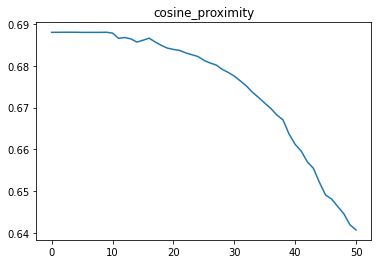

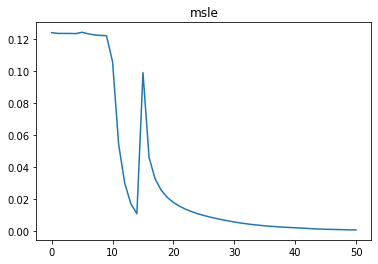

X_test.shape :  (10000, 1500, 1)
y_test.shape :  (10000, 1500, 1)
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1, 1)
After reshaping...
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1)
{fromRealToComplex} vect_im.shape :  (1, 750)
{fromRealToComplex} vect_im.shape :  (1, 750)
[channel] qzt : [[ 5.14537068e-01+2.66219635e-01j -1.06614302e-01+5.61374909e-01j
   4.45955252e-01+6.28453247e-01j  2.62848505e-01+7.03914640e-01j
   5.12281935e-01+9.48706748e-01j -1.26308989e-01-5.14120161e-02j
  -1.28234528e-01+4.53183884e-01j -1.92490823e-01+1.12102747e+00j
  -5.28126035e-01+8.22673958e-01j  3.91619626e-01+8.09660457e-01j
   5.91216187e-01+1.02384213e+00j  4.73906673e-01+2.32851642e-01j
  -9.02074508e-02+6.13133092e-01j  4.55383741e-01+1.39162992e-01j
  -5.08670884e-01+1.04320200e+00j  5.12573390e-01+7.87222636e-01j
   3.52768987e-01+6.21673305e-01j  7.63582921e-01+5.96759549e-01j
   2.24500198e-01+2.50248939e-01j  4.52955271e-01-4.00555058e-01j
   5.98335171e-01+1.68247922e-02j  3.93274571e-02+

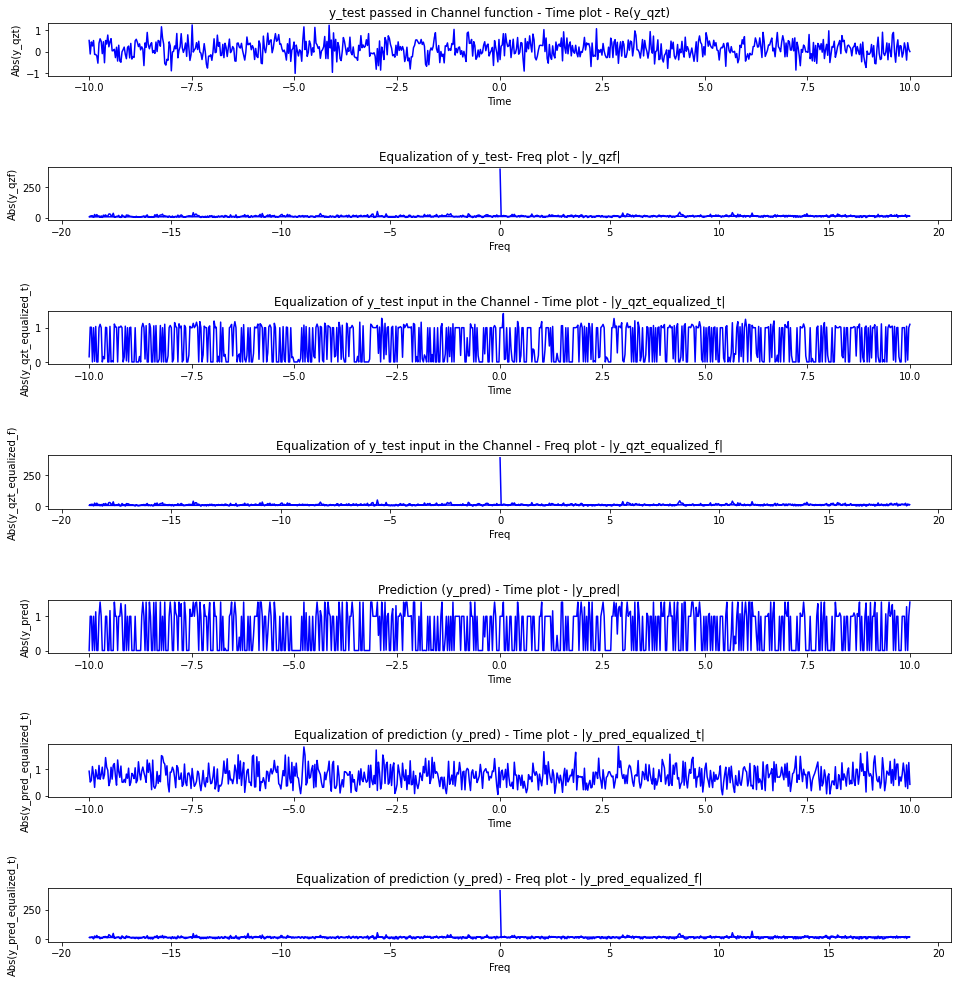

In [ ]:
# testing the model
index_pred = 150
with_error_plots = True
y_pred = test_model(model_lstm, X_test, y_test, history, index_pred, with_error_plots)

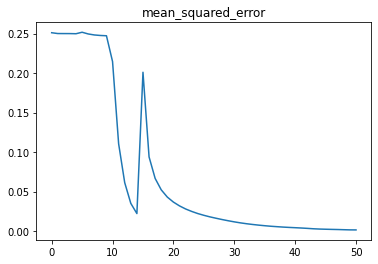

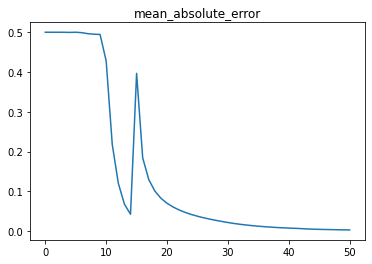

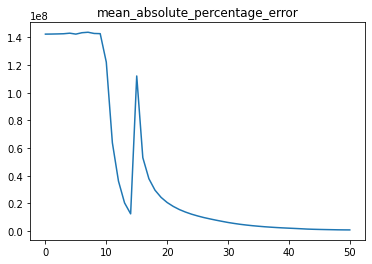

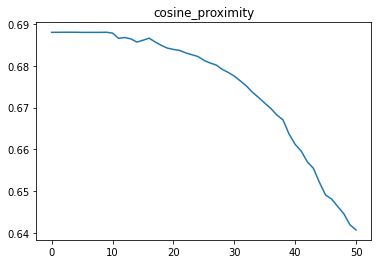

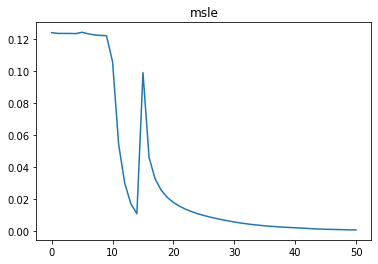

X_test.shape :  (10000, 1500, 1)
y_test.shape :  (10000, 1500, 1)
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1, 1)
After reshaping...
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1)
{fromRealToComplex} vect_im.shape :  (1, 750)
{fromRealToComplex} vect_im.shape :  (1, 750)
[channel] qzt : [[ 5.14537068e-01+2.66219635e-01j -1.06614302e-01+5.61374909e-01j
   4.45955252e-01+6.28453247e-01j  2.62848505e-01+7.03914640e-01j
   5.12281935e-01+9.48706748e-01j -1.26308989e-01-5.14120161e-02j
  -1.28234528e-01+4.53183884e-01j -1.92490823e-01+1.12102747e+00j
  -5.28126035e-01+8.22673958e-01j  3.91619626e-01+8.09660457e-01j
   5.91216187e-01+1.02384213e+00j  4.73906673e-01+2.32851642e-01j
  -9.02074508e-02+6.13133092e-01j  4.55383741e-01+1.39162992e-01j
  -5.08670884e-01+1.04320200e+00j  5.12573390e-01+7.87222636e-01j
   3.52768987e-01+6.21673305e-01j  7.63582921e-01+5.96759549e-01j
   2.24500198e-01+2.50248939e-01j  4.52955271e-01-4.00555058e-01j
   5.98335171e-01+1.68247922e-02j  3.93274571e-02+

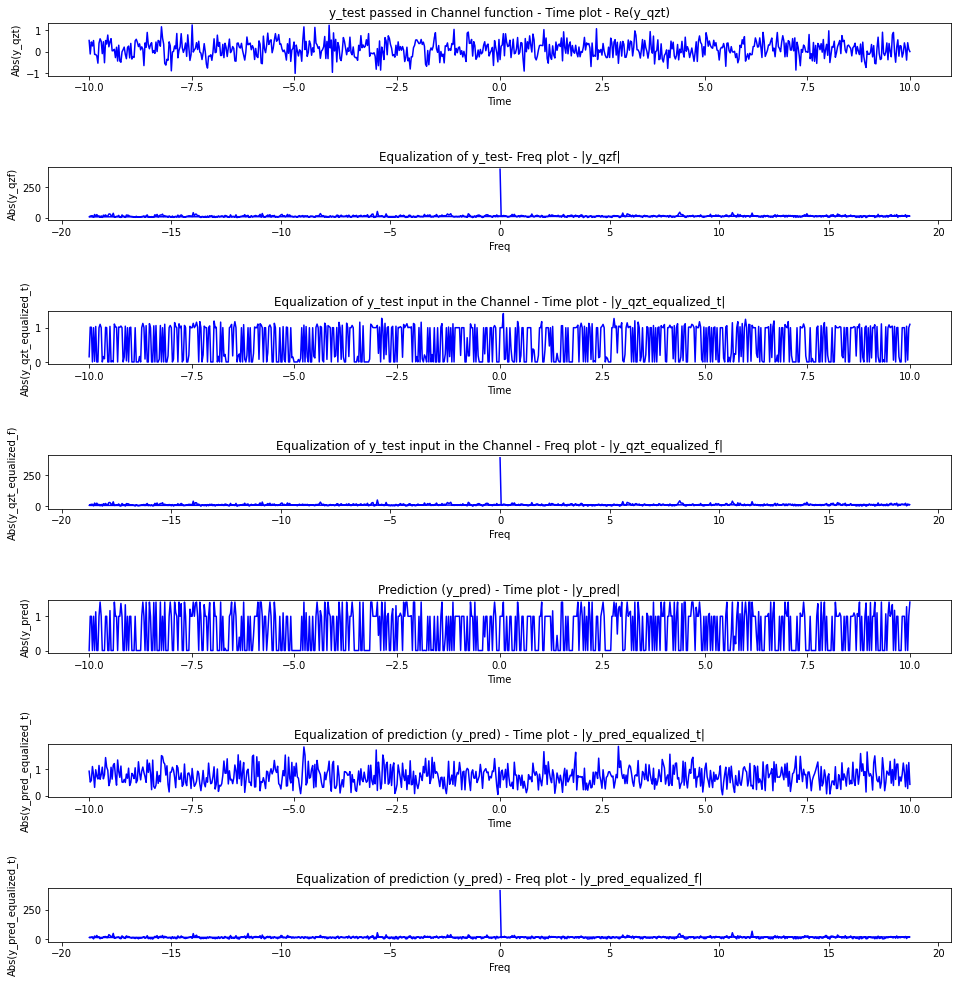

In [ ]:
# testing the model
index_pred = 951
with_error_plots = True
y_pred = test_model(model_lstm, X_test, y_test, history, index_pred, with_error_plots)

In [ ]:
# testing the model
index_pred = 234
with_error_plots = True
y_pred = test_model(model_lstm, X_test, y_test, history, index_pred, with_error_plots)